# Análisis Exploratorio de Datos

Guillermo Luigui Ubaldo Nieto Angarita

## Guia

https://spotintelligence.com/2023/09/15/exploratory-data-analysis-nlp/

## Diccionario de Datos

Esta exploración se base en la identificación de las variedades lingüísticas y léxicas según su ubicación geográfica, los medios escritos con su tipo de sección; así como el reconocimiento de las entidades nombradas.

## Paso 1: Cargar Librerías

In [1]:
#!python -m spacy download es_core_news_lg

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
import os
import string
import spacy
import math
import networkx as nx
import unicodedata
import unidecode



from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.util import ngrams
from collections import Counter
from wordcloud import WordCloud
from itertools import combinations
from scipy import stats
from collections import defaultdict
from flair.data import Sentence
from flair.models import SequenceTagger
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from transformers import pipeline
from textstat import textstat
import hide_code
from spacy.lang.es.stop_words import STOP_WORDS
import ast

In [3]:
nltk.download('stopwords')
spanish_stopwords = stopwords.words('spanish')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\guill\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Paso 2: Cargar Datos

In [4]:
df = pd.read_excel("../datasets/exploration_datasets/silver/silver_df_news_balanced_df.xlsx")

In [5]:
# 🔹 Convert 'content_lemmes' column to strings
df["content_lemmes"] = df["content_lemmes"].apply(
    lambda x: " ".join(x) if isinstance(x, list) else str(x)
)

In [6]:
# Remove "El " or "La " only at the beginning of the string (case-sensitive)
df["newspaper"] = df["newspaper"].str.replace(r'^(El|La)\s+', '', regex=True)

In [7]:
#df = pd.read_json("../datasets/exploration_datasets/silver/silver_df_news.json", lines=True)

In [8]:
df.head()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
0,¿Qué enfermedad sufrió Gabriel García Márquez ...,cultura,Se cumplen 10 años desde que ‘Gabo’ falleció.....,Colombia,Semana,Se cumplen 10 años desde que ‘Gabo’ falleció...,Se cumplen 10 anos desde que Gabo fallecio.. E...,se cumplen 10 anos desde que gabo fallecio.. e...,['se cumplen 10 anos desde que gabo fallecio.....,se cumplen 10 anos desde que gabo fallecio el ...,cumplen 10 anos gabo fallecio mundo letras vis...,cumplen 10 anos gabo fallecio mundo letras vis...,"['cumplir', 'ano', 'gabo', 'fallecio', 'mundo'..."
1,"“Tiburón: la historia de un clásico”, el docum...",cultura,"A medio siglo de su estreno, Tiburón vuelve a ...",Colombia,El Colombiano,"A medio siglo de su estreno, Tiburón vuelve a...","A medio siglo de su estreno, Tiburon vuelve a ...","a medio siglo de su estreno, tiburon vuelve a ...","['a medio siglo de su estreno, tiburon vuelve ...",a medio siglo de su estreno tiburon vuelve a e...,siglo estreno tiburon vuelve escena documental...,siglo estreno tiburon vuelve escena documental...,"['siglo', 'estreno', 'tiburon', 'vuelve', 'esc..."
2,El “boom” de la literatura latinoamericana rev...,cultura,Décadas después del movimiento que convirtió a...,Colombia,Semana,Décadas después del movimiento que convirtio...,Decadas despues del movimiento que convirtio a...,decadas despues del movimiento que convirtio a...,['decadas despues del movimiento que convirtio...,decadas despues del movimiento que convirtio a...,decadas movimiento convirtio realismo magico s...,decadas movimiento convirtio realismo magico s...,"['decada', 'movimiento', 'convirtio', 'realism..."
3,Colombia brilló en Cannes: ‘Un Poeta’ ganó el ...,cultura,La película de Simón Mesa Soto fue galardonada...,Colombia,Semana,La película de Simón Mesa Soto fue galardona...,La pelicula de Simon Mesa Soto fue galardonada...,la pelicula de simon mesa soto fue galardonada...,['la pelicula de simon mesa soto fue galardona...,la pelicula de simon mesa soto fue galardonada...,pelicula simon mesa soto galardonada seccion m...,pelicula simon mesa soto galardonada seccion m...,"['pelicula', 'simon', 'mesa', 'soto', 'galardo..."
4,Este domingo en la FILBo habrá taller familiar...,cultura,"Será un espacio para leer, soñar, reír y refle...",Colombia,Semana,"Será un espacio para leer, soñar, reír y re...","Sera un espacio para leer, sonar, reir y refle...","sera un espacio para leer, sonar, reir y refle...","['sera un espacio para leer, sonar, reir y ref...",sera un espacio para leer sonar reir y reflexi...,espacio leer sonar reir reflexionar respeto em...,espacio leer sonar reir reflexionar respeto em...,"['espacio', 'leer', 'sonar', 'reir', 'reflexio..."


In [9]:
df.tail()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
4324,Recomiendan que vacuna contra gripe se aplique...,salud,Especialistas en pediatría presentaron un docu...,Mexico,Excelsior,Especialistas en pediatría presentaron un doc...,Especialistas en pediatria presentaron un docu...,especialistas en pediatria presentaron un docu...,['especialistas en pediatria presentaron un do...,especialistas en pediatria presentaron un docu...,especialistas pediatria presentaron documento ...,especialistas pediatria presentaron documento ...,"['especialista', 'pediatrio', 'presentar', 'do..."
4325,UE aprueba primera píldora para depresión posp...,salud,La UE autoriza la píldora zuranolona para trat...,Mexico,Excelsior,La UE autoriza la píldora zuranolona para tra...,La UE autoriza la pildora zuranolona para trat...,la ue autoriza la pildora zuranolona para trat...,['la ue autoriza la pildora zuranolona para tr...,la ue autoriza la pildora zuranolona para trat...,ue autoriza pildora zuranolona tratar depresio...,ue autoriza pildora zuranolona tratar depresio...,"['ue', 'autorizar', 'pildoro', 'zuranolón', 't..."
4326,“Hay que andar cazando las vacunas”: por desab...,salud,Familias crearon grupos en redes para avisar s...,Mexico,Animal Politico,Familias crearon grupos en redes para avisar s...,Familias crearon grupos en redes para avisar s...,familias crearon grupos en redes para avisar s...,['familias crearon grupos en redes para avisar...,familias crearon grupos en redes para avisar s...,familias crearon grupos redes avisar vacunas g...,familias crearon grupos redes avisar vacunas g...,"['familia', 'crear', 'grupo', 'redes', 'avisar..."
4327,IA ayuda a localizar lesiones cerebrales en ni...,salud,Una herramienta de inteligencia artificial loc...,Mexico,Excelsior,Una herramienta de inteligencia artificial loc...,Una herramienta de inteligencia artificial loc...,una herramienta de inteligencia artificial loc...,['una herramienta de inteligencia artificial l...,una herramienta de inteligencia artificial loc...,herramienta inteligencia artificial localiza l...,herramienta inteligencia artificial localiza l...,"['herramiento', 'inteligencia', 'artificial', ..."
4328,Cómo funcionan las vacunas y qué pasa en tu cu...,salud,Las vacunas enseñan al organismo a producir an...,Mexico,Excelsior,Las vacunas enseñan al organismo a producir a...,Las vacunas ensenan al organismo a producir an...,las vacunas ensenan al organismo a producir an...,['las vacunas ensenan al organismo a producir ...,las vacunas ensenan al organismo a producir an...,vacunas ensenan organismo producir anticuerpos...,vacunas ensenan organismo producir anticuerpos...,"['vacuna', 'ensenar', 'organismo', 'producir',..."


In [10]:
df.dtypes

title                                    object
category                                 object
content                                  object
country                                  object
newspaper                                object
content_unicode                          object
content_removed_unwanted_elements        object
content_lowercase                        object
content_sentence_tokenization            object
content_lowercase_with_no_punctuation    object
content_without_stopwords                object
content_tokens                           object
content_lemmes                           object
dtype: object

## Paso 3: Identificar las variedades lingüísticas por ubicación geográfica, prensa escrita y tipo de sección

### Paso 3.1: Distribución y estructura general

Analizar la composición del corpus por país, periódico y sección para entender el equilibrio de los datos y la representatividad de cada fuente.

#### Paso 3.1.1: ¿Cuántas noticias hay por país (Colombia vs. México)?

In [11]:
df['country'].value_counts()

country
Colombia    3029
Mexico      1300
Name: count, dtype: int64

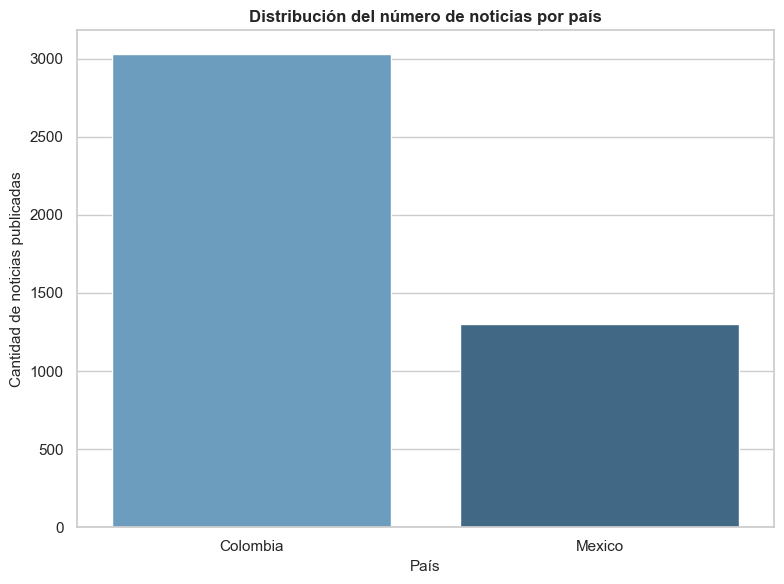

In [12]:
plt.figure(figsize=(8, 6))
sns.set_theme(style="whitegrid")  # clean academic background

sns.countplot(
    data=df,
    x='country',
    hue = 'country',
    palette="Blues_d",  # soft monochromatic palette
    legend=False
)

plt.title("Distribución del número de noticias por país", fontsize=12, fontweight='bold')
plt.xlabel("País", fontsize=11)
plt.ylabel("Cantidad de noticias publicadas", fontsize=11)
plt.tight_layout()
plt.show()

La Figura X presenta la distribución del número de noticias por país en el corpus utilizado para las tareas de question answering. Se observa que la mayoría de los textos provienen de Colombia (más de 2500), mientras que México contribuye con una cantidad menor (alrededor de 1000).

Esta diferencia indica una desproporción en la representación geográfica del corpus, lo cual puede influir en el proceso de entrenamiento o evaluación del modelo. En particular, un mayor número de textos colombianos puede hacer que el modelo aprenda patrones léxicos o contextuales más representativos de ese país, reduciendo su capacidad de generalización a otros contextos regionales del español. Por tanto, este desequilibrio debe considerarse al momento de optimizar el rendimiento y la equidad del sistema de question answering.

#### Paso 3.1.2: ¿Cuáles son los periódicos con mayor número de textos en cada país?

In [13]:
df.groupby(['country', 'newspaper']).size().reset_index(name='num_texts').sort_values(['country', 'num_texts'], ascending=[True, False])

,country,newspaper,num_texts
2,Colombia,Semana,1199
0,Colombia,El Colombiano,774
1,Colombia,El Espectador,650
3,Colombia,Tiempo,406
5,Mexico,Excelsior,664
4,Mexico,Animal Politico,377
6,Mexico,Jornada,233
7,Mexico,Universal,26


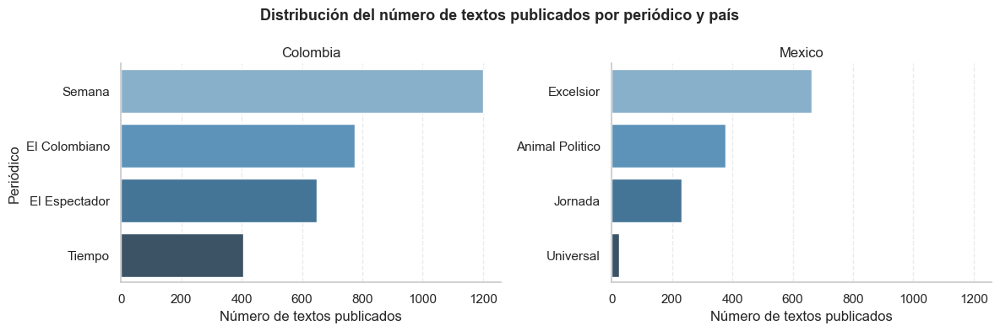

In [14]:
# --- Group the data: number of texts by newspaper and country ---
newspaper_counts = (
    df.groupby(['country', 'newspaper'])
      .size()
      .reset_index(name='num_texts')
)

# --- Sort within each country ---
newspaper_counts = newspaper_counts.sort_values(
    ['country', 'num_texts'], ascending=[True, False]
)

# --- Set academic visual style ---
sns.set_theme(style="whitegrid")

# --- Create the FacetGrid (≈6x4 per facet) ---
g = sns.FacetGrid(
    newspaper_counts,
    col='country',
    sharex=True,
    sharey=False,
    height=4,
    aspect=1.5
)

# --- Plot ---
g.map_dataframe(
    sns.barplot,
    x='num_texts',
    y='newspaper',
    hue='newspaper',
    palette='Blues_d',
    dodge=False,
    legend=False
)

# --- Customize the layout ---
g.set_titles(col_template='{col_name}')
g.set_axis_labels('Número de textos publicados', 'Periódico')
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribución del número de textos publicados por periódico y país',
               fontsize=13, fontweight='bold')

for ax in g.axes.flatten():
    ax.grid(True, axis='x', linestyle='--', alpha=0.4)
    ax.set_facecolor('white')

plt.tight_layout()
plt.show()


La Figura X muestra la distribución del número de textos publicados por periódico y país. Se observa un predominio de fuentes colombianas, lo que refuerza el sesgo identificado en la composición del corpus. En Colombia, los periódicos Semana y El Colombiano concentran la mayor cantidad de textos, mientras que en México, la mayoría proviene de Excélsior y Animal Político.

Esta desigualdad en la representación de fuentes puede influir en la diversidad lingüística y temática del corpus, afectando la optimización del modelo de question answering. En particular, la sobre-representación de ciertos periódicos puede inducir un sesgo estilístico o contextual, haciendo que el modelo aprenda patrones específicos de esas fuentes y disminuya su capacidad de generalización a otros medios o regiones.

#### Paso 3.1.3: ¿Qué proporción de textos hay por tipo de categoría?

In [15]:
df['category'].value_counts(normalize=True)

category
cultura          0.368676
politica         0.273966
internacional    0.181566
salud            0.113652
economia         0.062139
Name: proportion, dtype: float64

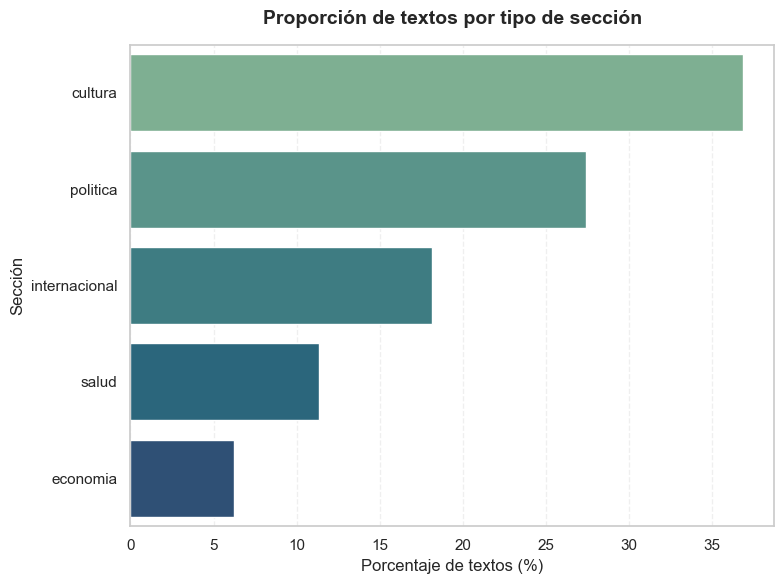

In [16]:
# --- Calcular proporción de textos por tipo de sección ---
category_counts = (
    df['category']  # 👈 corregido: 'category' en minúscula
    .value_counts(normalize=True)
    .reset_index()
)
category_counts.columns = ['category', 'percentage']
category_counts['percentage'] *= 100

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # tamaño óptimo para tesis en Word
sns.barplot(
    data=category_counts,
    x='percentage',
    y='category',
    hue='category',
    palette='crest',  # paleta profesional y legible
    legend=False
)

# --- Personalización del gráfico ---
plt.title(
    'Proporción de textos por tipo de sección',
    fontsize=14,
    weight='bold',
    pad=15
)
plt.xlabel('Porcentaje de textos (%)', fontsize=12)
plt.ylabel('Sección', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.3)

# --- Ajustar diseño ---
plt.tight_layout()
plt.show()

La Figura X muestra la proporción de textos por tipo de sección en el corpus analizado. Se observa que la categoría política es la más representada, con más del 25 % de los textos, seguida de las secciones internacional, económica y cultural, que también presentan una participación significativa. En contraste, las categorías judicial y seguridad cuentan con una representación mínima.

Esta distribución evidencia un sesgo temático hacia contenidos políticos y económicos, lo cual es relevante para las tareas de question answering, ya que el modelo podría optimizar su desempeño en preguntas relacionadas con estos temas, pero mostrar rendimiento limitado en categorías con menor presencia textual. Por tanto, resulta necesario considerar estrategias de balanceo o ponderación de datos para mejorar la cobertura temática y evitar que el modelo aprenda representaciones desproporcionadas de ciertos dominios.

#### Paso 3.1.4: ¿Cómo varía la proporción de textos por tipo de sección entre Colombia y México dentro del corpus utilizado para la optimización del modelo de question answering?

C:\Users\guill\AppData\Local\Temp\ipykernel_40588\2917228533.py:19: UserWarning: The palette list has more values (8) than needed (5), which may not be intended.
  sns.barplot(


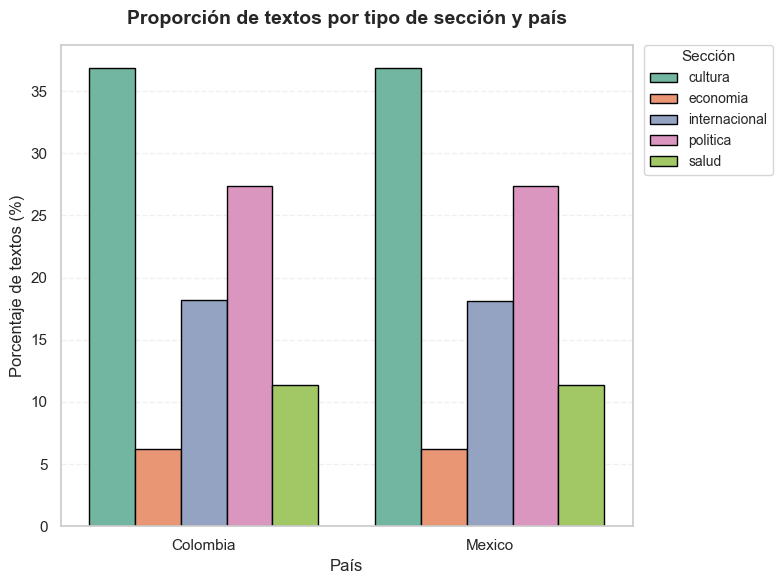

In [17]:
# --- Calcular número y proporción de textos por país y tipo de sección ---
category_counts = (
    df.groupby(['country', 'category'])
      .size()
      .reset_index(name='count')
)

category_counts['percentage'] = (
    category_counts['count'] /
    category_counts.groupby('country')['count'].transform('sum') * 100
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # Tamaño estándar para tesis en Word

# Paleta con alto contraste y colorblind-safe
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10", "Dark2", "Paired"

sns.barplot(
    data=category_counts,
    x='country',
    y='percentage',
    hue='category',
    palette=palette_contrast,
    edgecolor='black'  # bordes para resaltar barras
)

# --- Personalización ---
plt.title(
    'Proporción de textos por tipo de sección y país',
    fontsize=14,
    weight='bold',
    pad=15
)
plt.xlabel('País', fontsize=12)
plt.ylabel('Porcentaje de textos (%)', fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis='y', linestyle='--', alpha=0.3)

# --- Leyenda ---
plt.legend(
    title='Sección',
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc='upper left',
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()



La Figura X muestra la proporción de textos por tipo de sección y país. En ambos casos, se observa un predominio de la sección política, seguida de las categorías internacional y económica. Sin embargo, las proporciones son similares entre los dos países, lo que sugiere una consistencia temática general del corpus, aunque con ligeras diferencias en las secciones cultural y salud.

Este patrón indica que, a pesar de la diferencia en el número total de textos, el contenido temático de Colombia y México mantiene una distribución comparable, lo cual es relevante para las tareas de question answering, ya que permite al modelo aprender representaciones semánticas homogéneas entre países, reduciendo el riesgo de sesgo temático.

#### Paso 3.1.5: ¿Qué longitud promedio tienen los textos (en palabras o oraciones) por país, periódico y sección?

In [18]:
df["content_sentence_tokenization"][1]

"['a medio siglo de su estreno, tiburon vuelve a escena con un documental que revela imagenes ineditas, entrevistas exclusivas y nuevas lecturas sobre la cinta que transformo el cine, el miedo a los tiburones y la conservacion marina..', 'national geographic conmemora el aniversario numero 50 del estreno de tiburon con el unico documental autorizado sobre la iconica pelicula , que contara con entrevistas nuevas a steven spielberg y se estrenara el 10 de julio en disney.', 'lea tambien: murio ron taylor, el oceanografo que filmo la pelicula tiburon titulado tiburon: la historia de un clasico , el especial es dirigido por laurent bouzereau , responsable de producciones como la musica de john williams , y producido por amblin documentaries y nedland films .', 'a lo largo de 90 minutos, el documental reconstruye el fenomeno cinematografico que no solo lanzo la carrera de spielberg, sino que transformo el cine moderno y la forma en que el mundo ve a los tiburones.', 'el documental incluye m

In [19]:
import ast

def safe_eval(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            val = ast.literal_eval(x)
            return val if isinstance(val, list) else []
        except (ValueError, SyntaxError):
            return []
    return []

df["content_sentence_tokenization"] = df["content_sentence_tokenization"].apply(safe_eval)

In [20]:
# Count number of sentences and words per text
df["num_sentences"] = df["content_sentence_tokenization"].apply(
    lambda x: len(x) if isinstance(x, list) else 0
)

df["num_words"] = df["content_tokens"].apply(
    lambda x: len(str(x).split()) if isinstance(x, str) else 0
)


In [21]:
# Create the grouped dataframe
avg_length = (
    df.groupby(["country", "newspaper", "category"])
    .agg(
        avg_words=("num_words", "mean"),
        avg_sentences=("num_sentences", "mean")
    )
    .reset_index()
)

# Separate and print by country
for country, group in avg_length.groupby("country"):
    print(f"\n=== {country.upper()} ===")
    print(group.sort_values(by="avg_words", ascending=False).to_string(index=False))


=== COLOMBIA ===
 country     newspaper      category  avg_words  avg_sentences
Colombia        Semana       cultura 441.795804      39.830769
Colombia El Colombiano      politica 368.578947      31.989474
Colombia El Colombiano      economia 339.492308      30.892308
Colombia El Colombiano       cultura 323.979798      28.469697
Colombia        Semana         salud 301.669725      23.788991
Colombia        Tiempo      politica 301.474138      26.120690
Colombia El Colombiano         salud 299.130435      22.739130
Colombia        Tiempo      economia 286.269231      19.346154
Colombia El Colombiano internacional 277.636888      21.469741
Colombia        Tiempo       cultura 260.064516      24.838710
Colombia        Semana      politica 251.074074      22.727273
Colombia        Semana      economia 225.294872      17.961538
Colombia        Tiempo         salud 215.448718      18.179487
Colombia        Tiempo internacional 197.032258      15.161290
Colombia El Espectador       cultura 

In [22]:
df[(df["country"] == "Mexico") & (df["category"] == "economica")]["content"]

Series([], Name: content, dtype: object)

C:\Users\guill\AppData\Local\Temp\ipykernel_40588\367525673.py:15: UserWarning: The palette list has more values (8) than needed (2), which may not be intended.
  sns.barplot(


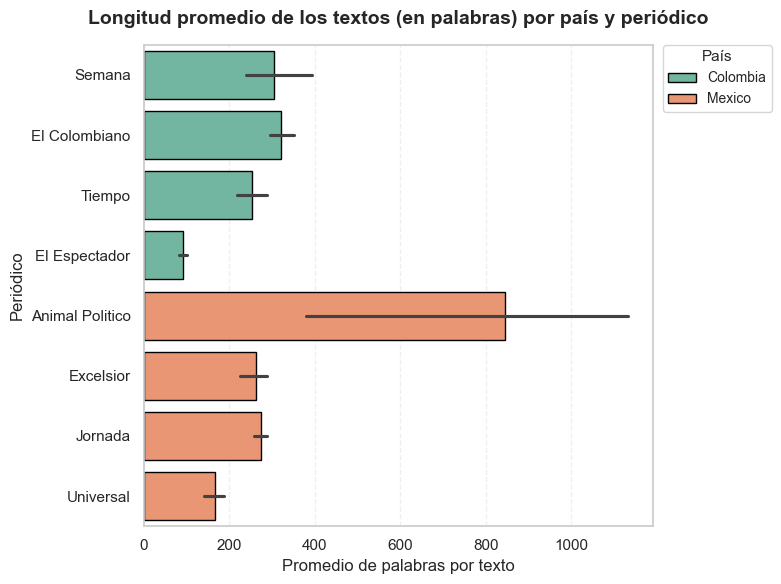

In [23]:
# --- Calcular orden de los periódicos por país y longitud promedio ---
order = (
    avg_length
    .sort_values(by=["country", "avg_words"], ascending=[True, False])
    .newspaper
    .unique()
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # Tamaño óptimo para informes y tesis

# Paleta con buen contraste y accesible (colorblind-safe)
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10" o "Dark2"

sns.barplot(
    data=avg_length,
    x="avg_words",
    y="newspaper",
    hue="country",
    order=order,
    palette=palette_contrast,
    edgecolor="black"
)

# --- Personalización del gráfico ---
plt.title(
    "Longitud promedio de los textos (en palabras) por país y periódico",
    fontsize=14,
    weight="bold",
    pad=15
)
plt.xlabel("Promedio de palabras por texto", fontsize=12)
plt.ylabel("Periódico", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis="x", linestyle="--", alpha=0.3)

# --- Leyenda ---
plt.legend(
    title="País",
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc="upper left",
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()


La Figura X muestra la longitud promedio de los textos (en palabras) agrupada por país y periódico. En general, los periódicos de México presentan textos más extensos que los de Colombia, destacándose Animal Político, con un promedio superior a las 900 palabras por texto. En contraste, los periódicos colombianos como Semana, El Colombiano y El Tiempo muestran longitudes promedio cercanas a las 350 palabras.

No obstante, esta diferencia también revela un posible sesgo de fuente, ya que Animal Político contribuye de manera significativa al corpus mexicano, lo que podría influir en la representación general de ese país.

Desde la perspectiva del question answering, este sesgo puede tener implicaciones importantes: los textos más largos ofrecen contextos más ricos, pero también más complejos, lo que puede afectar el tiempo de procesamiento, la precisión de extracción de respuestas y la generalización del modelo. Por tanto, este aspecto debe considerarse en las estrategias de segmentación, preprocesamiento y optimización del contexto durante el entrenamiento.

C:\Users\guill\AppData\Local\Temp\ipykernel_40588\3698018733.py:15: UserWarning: The palette list has more values (8) than needed (2), which may not be intended.
  sns.barplot(


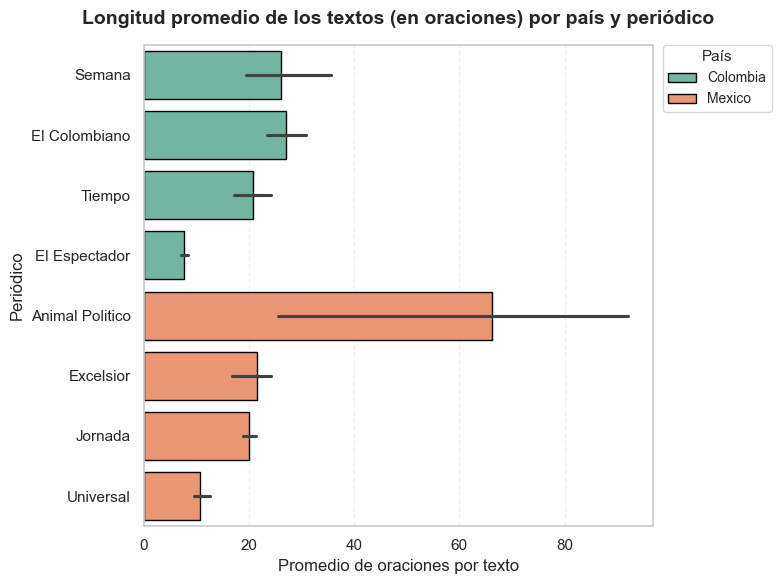

In [24]:
# --- Calcular orden de los periódicos por país y longitud promedio (en oraciones) ---
order = (
    avg_length
    .sort_values(by=["country", "avg_sentences"], ascending=[True, False])
    .newspaper
    .unique()
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))   # Tamaño estándar para tesis

# Paleta con alto contraste y accesible (colorblind-safe)
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10" o "Dark2"

sns.barplot(
    data=avg_length,
    x="avg_sentences",
    y="newspaper",
    hue="country",
    order=order,
    palette=palette_contrast,
    edgecolor="black"
)

# --- Personalización del gráfico ---
plt.title(
    "Longitud promedio de los textos (en oraciones) por país y periódico",
    fontsize=14,
    weight="bold",
    pad=15
)
plt.xlabel("Promedio de oraciones por texto", fontsize=12)
plt.ylabel("Periódico", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis="x", linestyle="--", alpha=0.3)

# --- Leyenda ---
plt.legend(
    title="País",
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc="upper left",
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()


La Figura X muestra la longitud promedio de los textos medida en oraciones, agrupada por país y periódico. En general, los textos de los periódicos mexicanos tienden a contener más oraciones que los colombianos, destacándose Animal Político con un promedio cercano a las 70 oraciones por texto. En contraste, medios colombianos como Semana, El Colombiano y El Tiempo presentan textos más breves, con alrededor de 30 oraciones en promedio.

A diferencia de la longitud en palabras, la cantidad de oraciones es un indicador más relevante para tareas de question answering, ya que determina la estructura y segmentación semántica del texto. Los textos con mayor número de oraciones ofrecen más unidades discursivas y posibles ubicaciones de respuesta, lo que puede mejorar la cobertura contextual del modelo. Sin embargo, este mismo rasgo incrementa la complejidad sintáctica y la dispersión de la información, dificultando la localización precisa de las respuestas.

En este sentido, el sesgo introducido por Animal Político —con textos sustancialmente más largos— debe considerarse en la optimización del contexto y las estrategias de segmentación, asegurando un equilibrio entre riqueza informativa y eficiencia en la extracción de respuestas.

### Paso 3.2: Variedades lingüísticas y léxicas

Propósito:
Identificar las diferencias léxicas y expresiones regionales que caracterizan las variedades del español en ambos países y secciones.

#### Paso 3.2.1: ¿Cuáles son las palabras y temas más prominentes que diferencian el foco de atención (variedad léxica y temática) de los documentos de Colombia respecto a los de México, en diversas categorías de contenido?


✅ Top words by raw frequency:
         word  count   country
0    colombia   2511  Colombia
1  colombiano   2319  Colombia
2  presidente   2229  Colombia
3     persona   2188  Colombia
4        vida   2126  Colombia


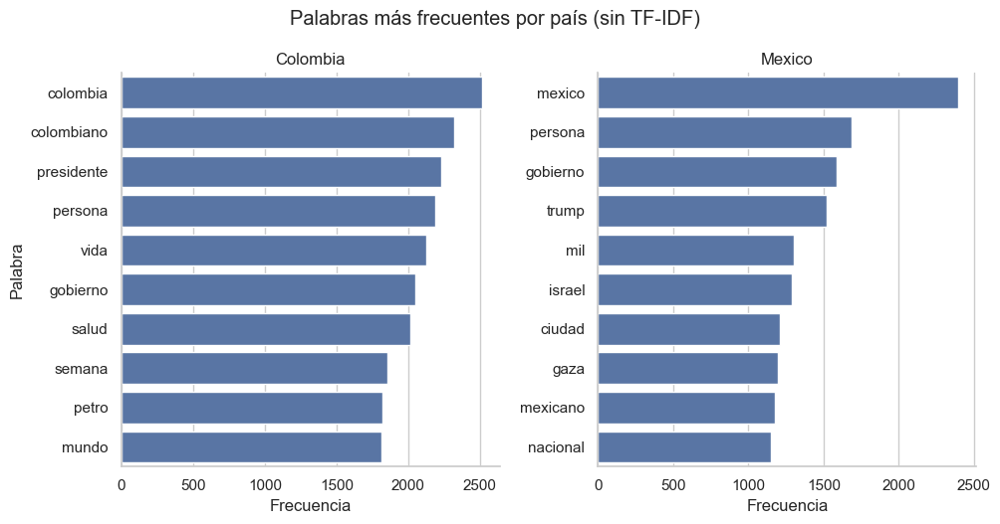

In [25]:
import ast
from collections import Counter
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def to_lemma_list(x):
    """
    Return a list of lemmas from x, excluding the token 'ano'.
    - If x is already a list -> return it.
    - If x is a string representing a Python list -> ast.literal_eval it.
    - If x is a plain string of words -> split on whitespace.
    - Otherwise -> return empty list.
    """
    if isinstance(x, list):
        return [i for i in x if isinstance(i, str) and i.lower() != "ano"]

    if isinstance(x, str):
        s = x.strip()
        if not s:
            return []
        try:
            parsed = ast.literal_eval(s)
            if isinstance(parsed, (list, tuple)):
                return [str(i) for i in parsed if i is not None and str(i).lower() != "ano"]
        except Exception:
            return [w for w in s.split() if w.lower() != "ano"]

    return []

# --------- BUILD CORPORA ----------
corpora = {}
for country in df["country"].unique():
    texts = []
    rows = df.loc[df["country"] == country, "content_lemmes"].tolist()
    for lemmas in rows:
        lem_list = to_lemma_list(lemmas)
        if lem_list:
            texts.append(lem_list)     # <- now store lists, not strings
    corpora[country] = texts

# --------- COMPUTE TOP WORDS BY RAW FREQUENCY ----------
top_words_list = []

for country, texts in corpora.items():

    # flatten all lemmas into one big list
    all_words = [w for doc in texts for w in doc if isinstance(w, str)]

    if not all_words:
        print(f"⚠️ Skipping {country}: no valid words.")
        continue

    # frequency count
    freq = Counter(all_words).most_common(10)

    top_words = pd.DataFrame({
        "word": [w for w, _ in freq],
        "count": [c for _, c in freq],
        "country": country
    })

    top_words_list.append(top_words)

# Combine results
top_words_df = pd.concat(top_words_list, ignore_index=True)

print("\n✅ Top words by raw frequency:")
print(top_words_df.head())

# --------- PLOT ----------
g = sns.catplot(
    data=top_words_df,
    x="count", y="word",
    col="country",
    kind="bar",
    sharex=False, sharey=False,
    col_wrap=2,
    height=5, aspect=1
)

g.set_titles("{col_name}")
g.set_axis_labels("Frecuencia", "Palabra")
g.fig.suptitle("Palabras más frecuentes por país (sin TF-IDF)", y=1.05)
plt.show()

       word  count   country category
0  historia   1620  Colombia  cultura
1     libro   1593  Colombia  cultura
2      vida   1440  Colombia  cultura
3     mundo   1324  Colombia  cultura
4      obra   1192  Colombia  cultura


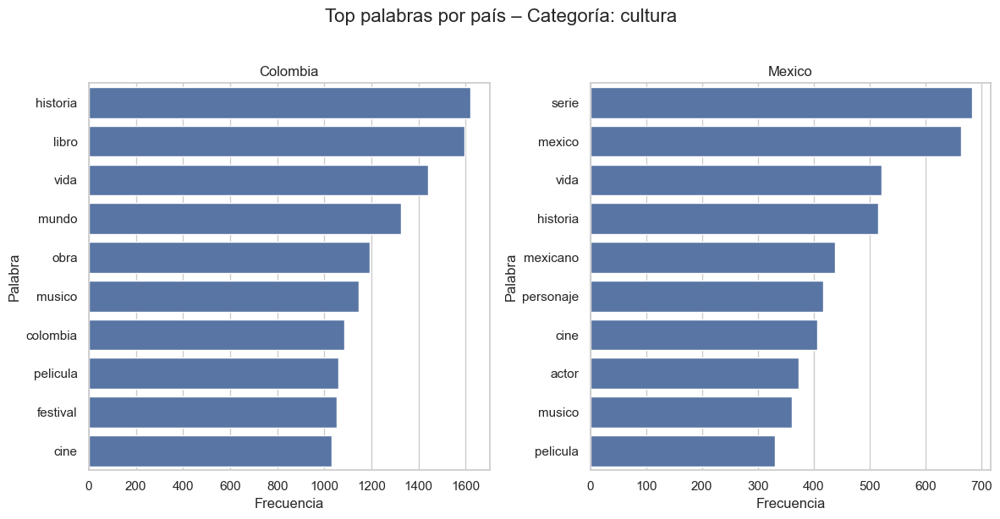

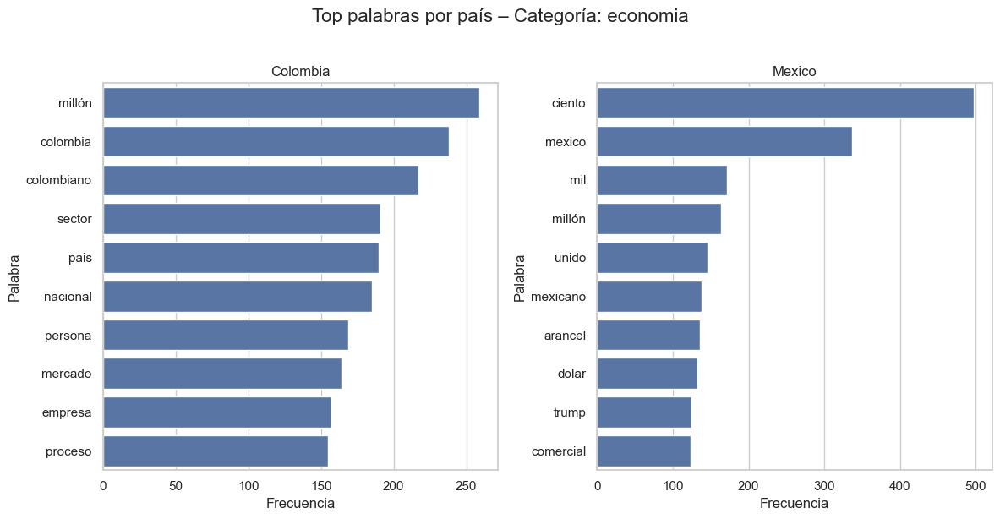

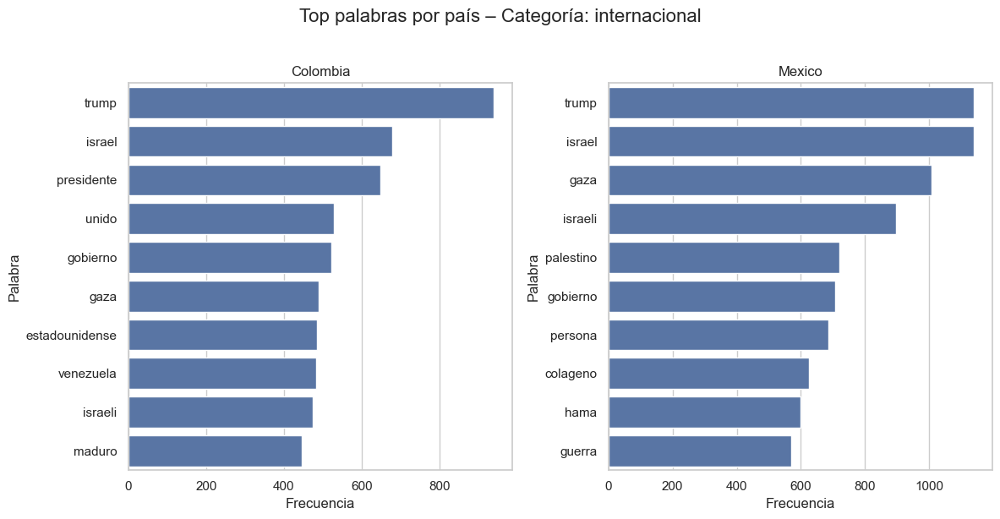

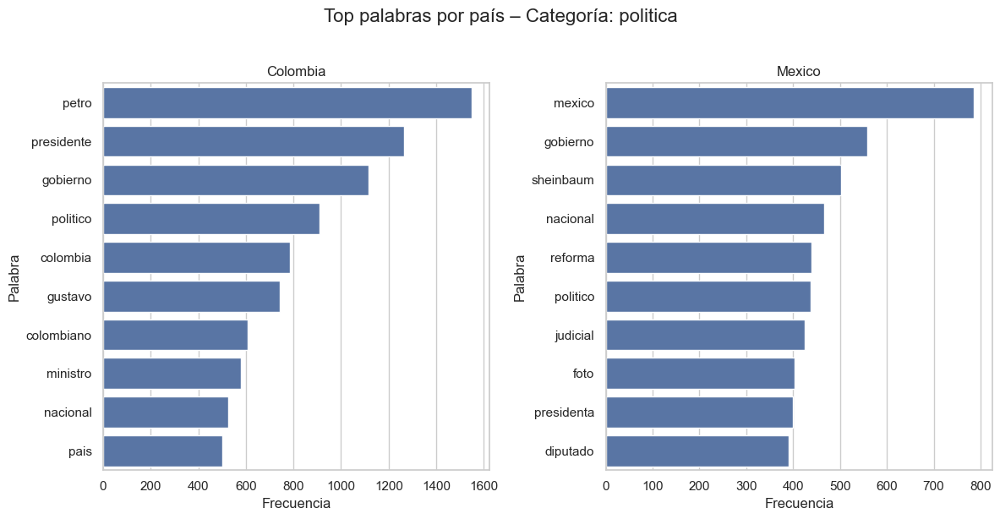

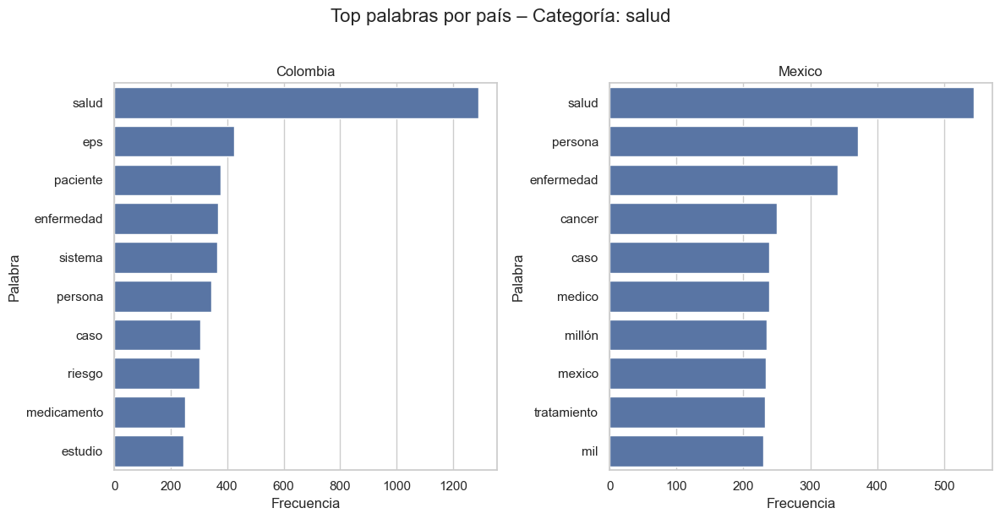

In [26]:
import ast
from collections import Counter
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def to_lemma_list(x):
    """
    Convert different input formats to a list of lemmas (excluding 'ano').
    """
    if isinstance(x, list):
        return [i for i in x if isinstance(i, str) and i.lower() != "ano"]

    if isinstance(x, str):
        s = x.strip()
        if not s:
            return []
        try:
            parsed = ast.literal_eval(s)
            if isinstance(parsed, (list, tuple)):
                return [str(i) for i in parsed
                        if i is not None and str(i).lower() != "ano"]
        except Exception:
            return [w for w in s.split() if w.lower() != "ano"]

    return []


# --------- COMPUTE TOP WORDS FOR COUNTRY × CATEGORY ----------
top_words_list = []

for (country, category), subset in df.groupby(["country", "category"]):

    texts = []
    for lemmas in subset["content_lemmes"]:
        lem_list = to_lemma_list(lemmas)
        if lem_list:
            texts.append(lem_list)

    # flatten
    all_words = [w for doc in texts for w in doc]

    if not all_words:
        print(f"⚠️ No words for {country} - {category}")
        continue

    freq = Counter(all_words).most_common(10)

    top_words_list.append(pd.DataFrame({
        "word": [w for w, _ in freq],
        "count": [c for _, c in freq],
        "country": country,
        "category": category
    }))

# Combine all
top_words_df = pd.concat(top_words_list, ignore_index=True)

print(top_words_df.head())


# --------- PLOT: ONE FIGURE PER CATEGORY, COUNTRIES SIDE-BY-SIDE ----------
categories = top_words_df["category"].unique()
countries = top_words_df["country"].unique()

for category in categories:

    subset_cat = top_words_df[top_words_df["category"] == category]

    # one row per category, N columns = # countries
    fig, axes = plt.subplots(
        1, len(countries),
        figsize=(6 * len(countries), 6),
        sharey=False
    )

    if len(countries) == 1:
        axes = [axes]

    for ax, country in zip(axes, countries):

        data_ctry = subset_cat[subset_cat["country"] == country]

        sns.barplot(
            data=data_ctry,
            x="count",
            y="word",
            ax=ax
        )

        ax.set_title(f"{country}")
        ax.set_xlabel("Frecuencia")
        ax.set_ylabel("Palabra")

    fig.suptitle(f"Top palabras por país – Categoría: {category}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


#### Paso 3.2.2: ¿Qué palabras son exclusivas o más frecuentes en los textos de Colombia frente a los de México?

In [27]:
# Normalize country names
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})

In [28]:
df.columns

Index(['title', 'category', 'content', 'country', 'newspaper',
       'content_unicode', 'content_removed_unwanted_elements',
       'content_lowercase', 'content_sentence_tokenization',
       'content_lowercase_with_no_punctuation', 'content_without_stopwords',
       'content_tokens', 'content_lemmes', 'num_sentences', 'num_words'],
      dtype='object')

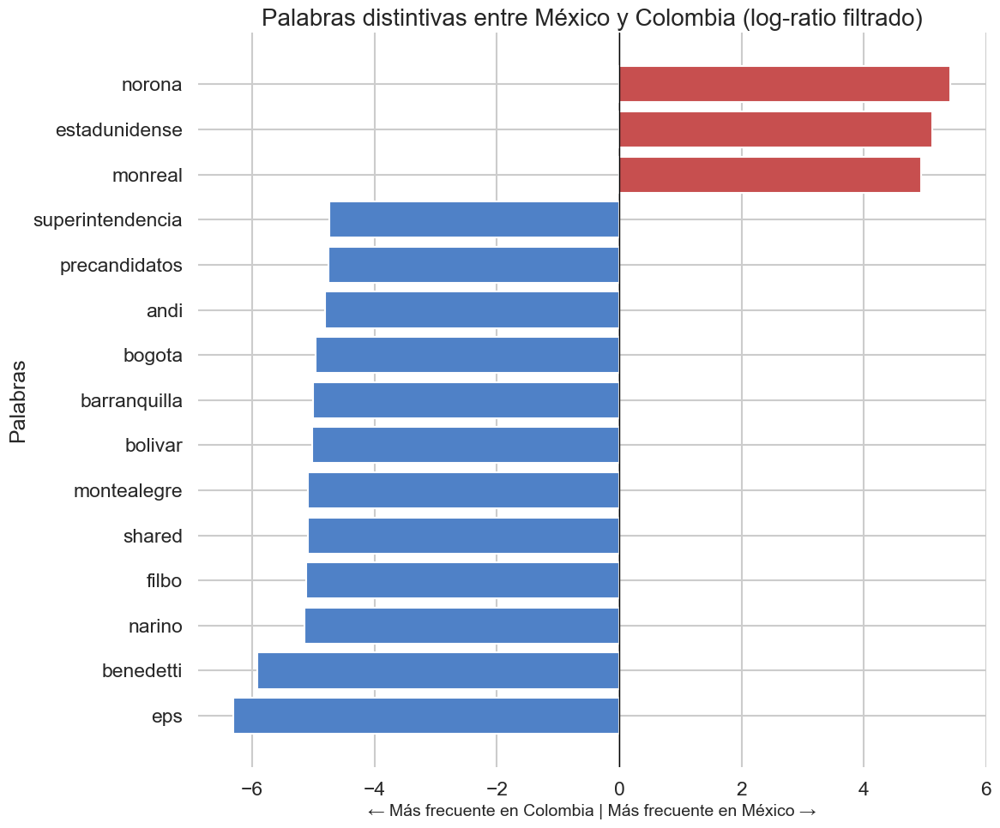

In [29]:
rows = []

for _, row in df.iterrows():
    country = row["country"]
    tokens = row["content_tokens"]

    # Si es string plano, lo convertimos a lista de tokens
    if isinstance(tokens, str):
        tokens = tokens.split()

    for token in tokens:
        rows.append((token, country))

freq_df = pd.DataFrame(rows, columns=["word", "country"])

freq_table = (
    freq_df
    .groupby(["word", "country"])
    .size()
    .reset_index(name="freq")
)

pivot = (
    freq_table.pivot_table(index="word", columns="country", values="freq", fill_value=0)
              .reset_index()
)

epsilon = 1  # evitar división por cero

pivot["ratio"] = (pivot["México"] + epsilon) / (pivot["Colombia"] + epsilon)

top_n = 12

top_mexico = pivot.nlargest(top_n, "ratio")
top_colombia = pivot.nsmallest(top_n, "ratio")

combined = pd.concat([top_mexico, top_colombia]).sort_values("ratio")


# -------------------------------
# 1. FILTRAR PALABRAS BASURA
# -------------------------------

remove_tokens = set([
    # marketing / redes
    "suscribete", "suscríbete", "noticias", "newsletter", "siguenos",
    "síguenos", "facebook", "twitter", "instagram", "canal",
    "activalas", "activarlas", "activalos", "activala",

    # bancos de imágenes
    "getty", "cuartoscuro", "foto", "fotos", "imagen", "images", "video",

    # instituciones políticas irrelevantes
    "imss", "issste", "pri", "pan", "prd", "morena"
])

def clean_word(w):
    w = str(w).lower()

    if w in remove_tokens:
        return False

    # excluir tokens muy cortos o con números
    if len(w) < 3:
        return False
    if any(char.isdigit() for char in w):
        return False

    return True

combined_clean = combined[combined["word"].apply(clean_word)].copy()

# -------------------------------
# 2. CALCULAR LOG-RATIO
# -------------------------------

combined_clean["log_ratio"] = np.log(
    (combined_clean["México"] + 1) / (combined_clean["Colombia"] + 1)
)

# -------------------------------
# 3. TOMAR TOP-PALABRAS DE CADA PAÍS
# -------------------------------

top_mexico = combined_clean.sort_values("log_ratio", ascending=False).head(15)
top_colombia = combined_clean.sort_values("log_ratio", ascending=True).head(15)

plot_df = pd.concat([top_colombia, top_mexico])

# -------------------------------
# 4. GRAFICAR
# -------------------------------

sns.set_style("whitegrid")
sns.set_context("talk")

colors = plot_df["log_ratio"].apply(lambda x: "#C74F4F" if x > 0 else "#4F81C7")

plt.figure(figsize=(12, 10))
plt.barh(plot_df["word"], plot_df["log_ratio"], color=colors)

plt.axvline(0, color="black", linewidth=1)

plt.title("Palabras distintivas entre México y Colombia (log-ratio filtrado)", fontsize=20)
plt.xlabel("← Más frecuente en Colombia | Más frecuente en México →", fontsize=14)
plt.ylabel("Palabras")

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()



#### Paso 3.2.2: ¿Qué palabras son más distintivas en cada categoría para los textos de Colombia y México?

In [30]:
# Normalize columns
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})
df["category"] = df["category"].str.strip().str.capitalize()

In [31]:
import ast

def to_lemma_list(x):
    """
    Return a list of lemmas from x, excluding the token 'ano'.
    - If x is already a list -> return it.
    - If x is a string representing a Python list -> ast.literal_eval it.
    - If x is a plain string of words -> split on whitespace.
    - Otherwise -> return empty list.
    """
    def clean_token(t):
        return isinstance(t, str) and t.lower() != "ano"

    if isinstance(x, list):
        return [i for i in x if clean_token(i)]

    if isinstance(x, str):
        s = x.strip()
        if not s:
            return []
        try:
            parsed = ast.literal_eval(s)
            if isinstance(parsed, (list, tuple)):
                return [str(i) for i in parsed if i is not None and clean_token(i)]
        except Exception:
            return [w for w in s.split() if clean_token(w)]

    return []


# --- Build nested corpora by country and category ---
corpora = {}

for (country, category), group in df.groupby(["country", "category"]):
    texts = []
    for lemmas in group["content_lemmes"]:
        lem_list = to_lemma_list(lemmas)
        if lem_list:
            texts.append(" ".join(lem_list))

    if texts:
        corpora.setdefault(country, {})[category] = texts


In [32]:
top_words_list = []

for country, categories in corpora.items():
    for category, texts in categories.items():
        # Remove empty or non-string entries
        texts = [t for t in texts if isinstance(t, str) and t.strip()]

        if len(texts) == 0:
            print(f"⚠️ Skipping {country} | {category}: no valid texts.")
            continue

        vectorizer = TfidfVectorizer(
            stop_words=spanish_stopwords,
            max_features=10000
        )

        try:
            tfidf = vectorizer.fit_transform(texts)
        except ValueError:
            print(f"⚠️ Skipping {country} | {category}: empty vocabulary (likely all stop words).")
            continue

        # Average TF-IDF per word
        tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())
        mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

        # Save for plotting or later analysis
        top_words = pd.DataFrame({
            "word": mean_tfidf.index,
            "tfidf": mean_tfidf.values,
            "country": country,
            "category": category
        })
        top_words_list.append(top_words)

# Combine all top words
if top_words_list:
    top_words_all = pd.concat(top_words_list, ignore_index=True)
else:
    top_words_all = pd.DataFrame(columns=["word", "tfidf", "country", "category"])

print("\n✅ Top words computed successfully:")
print(top_words_all.head())



✅ Top words computed successfully:
       word     tfidf   country category
0     libro  0.027667  Colombia  Cultura
1  festival  0.022349  Colombia  Cultura
2  historia  0.022225  Colombia  Cultura
3  pelicula  0.021108  Colombia  Cultura
4      cine  0.020666  Colombia  Cultura


In [33]:
rows = []

for _, row in df.iterrows():
    country = row["country"]
    category = row["category"]
    tokens = row["content_tokens"]

    # Convertir string → lista de tokens
    if isinstance(tokens, str):
        tokens = tokens.split()

    for token in tokens:
        rows.append((token, country, category))

# Construir dataframe base
freq_df = pd.DataFrame(rows, columns=["word", "country", "category"])

# Frecuencias por palabra, país y categoría
freq_table = (
    freq_df
    .groupby(["word", "country", "category"])
    .size()
    .reset_index(name="freq")
)

# Pivot: palabra como filas, combinaciones país–categoría como columnas
pivot = freq_table.pivot_table(
    index="word",
    columns=["country", "category"],
    values="freq",
    fill_value=0
).reset_index()

# Renombrar columnas multi-índice para facilidad
pivot.columns = ['word'] + [
    f"{c1}_{c2}" for c1, c2 in pivot.columns.tolist()[1:]
]

# Ejemplo: si tienes Colombia/Política, México/Política, etc.
# ratio entre países dentro de la misma categoría

epsilon = 1

# Crear ratios automáticamente por categoría
ratio_cols = []
for col in pivot.columns:
    if "México_" in col:
        cat = col.split("_", 1)[1]
        col_mex = col
        col_col = f"Colombia_{cat}"
        if col_col in pivot.columns:
            ratio_name = f"ratio_{cat}"
            pivot[ratio_name] = (pivot[col_mex] + epsilon) / (pivot[col_col] + epsilon)
            ratio_cols.append(ratio_name)

In [34]:
print([c for c in pivot.columns if "México_" in c or "Colombia_" in c])


['Colombia_Cultura', 'Colombia_Economia', 'Colombia_Internacional', 'Colombia_Politica', 'Colombia_Salud', 'México_Cultura', 'México_Economia', 'México_Internacional', 'México_Politica', 'México_Salud']


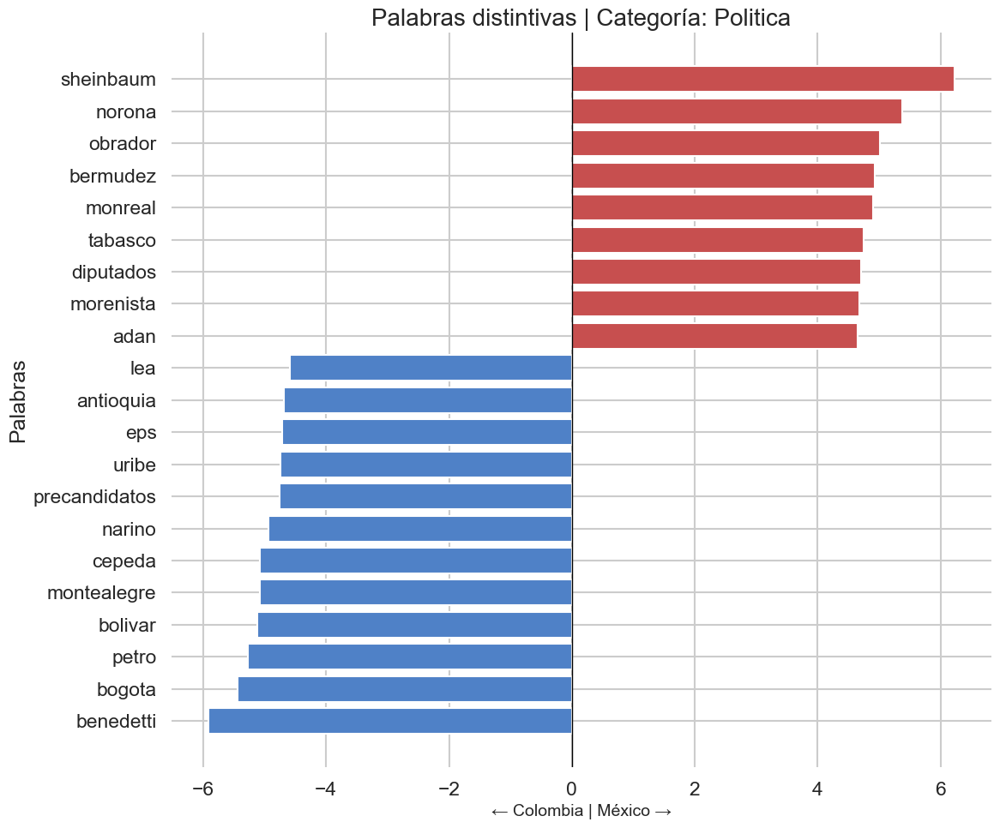

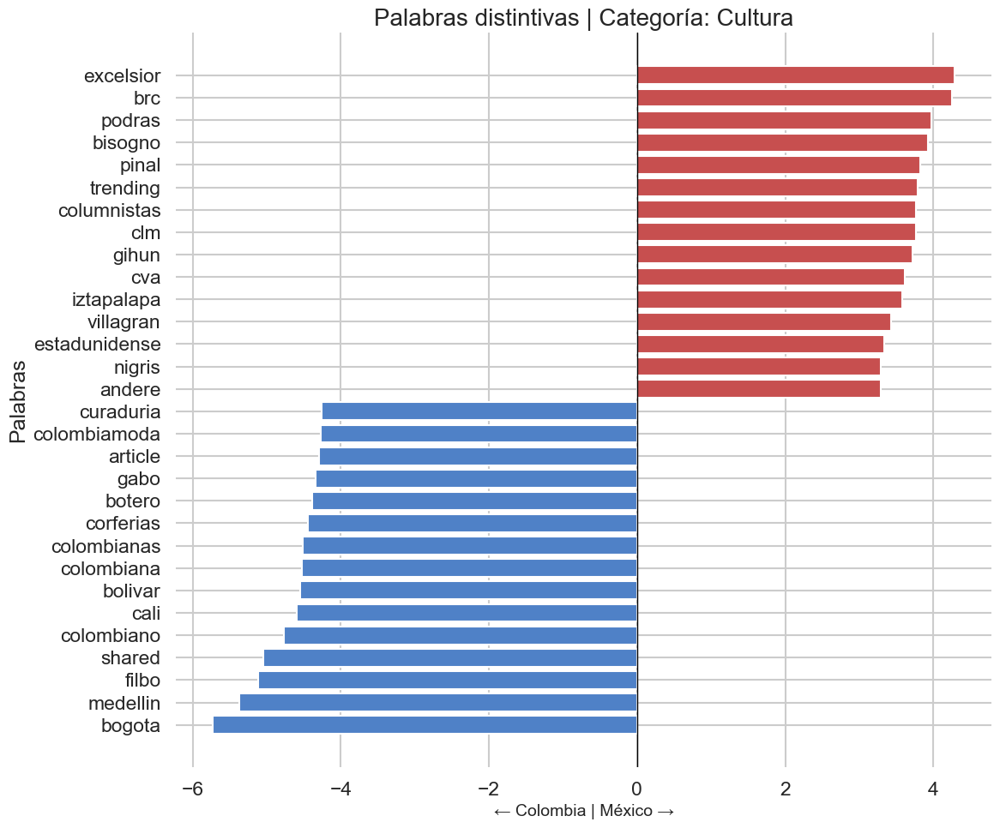

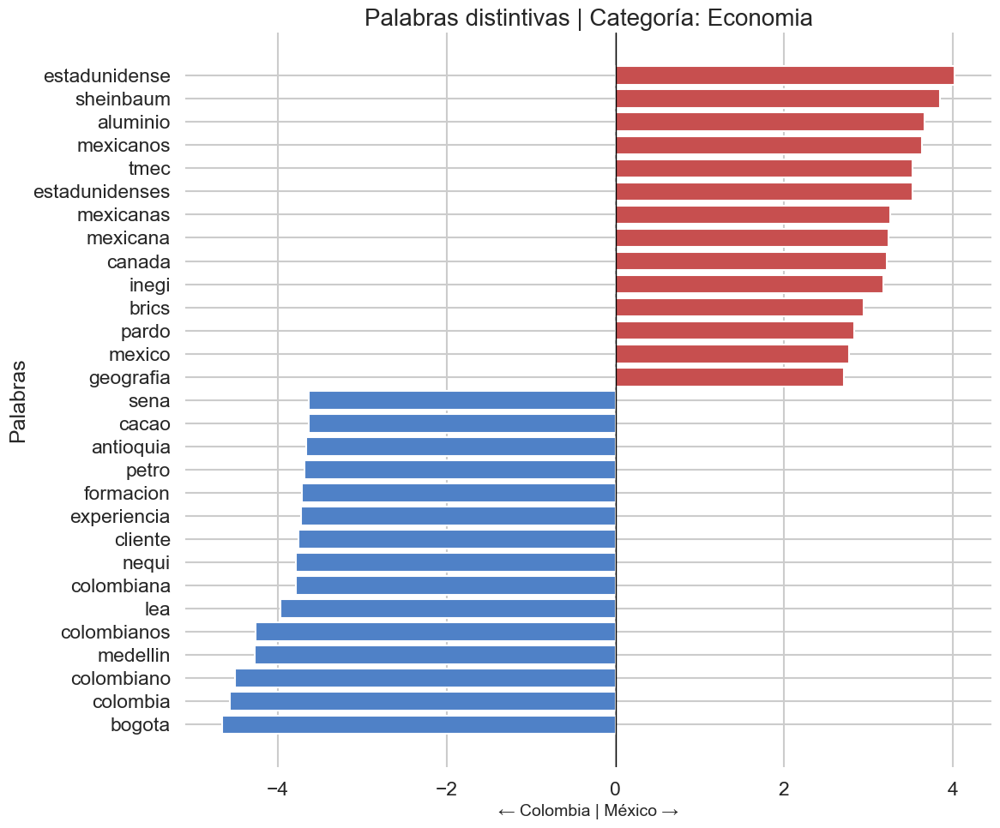

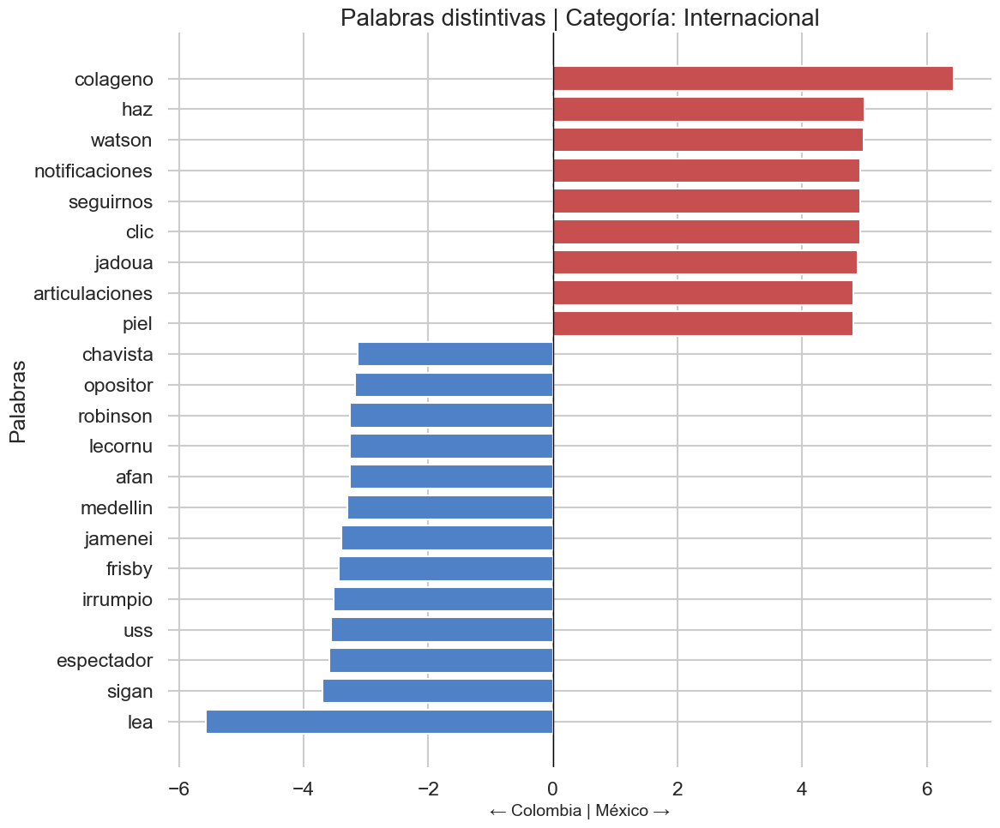

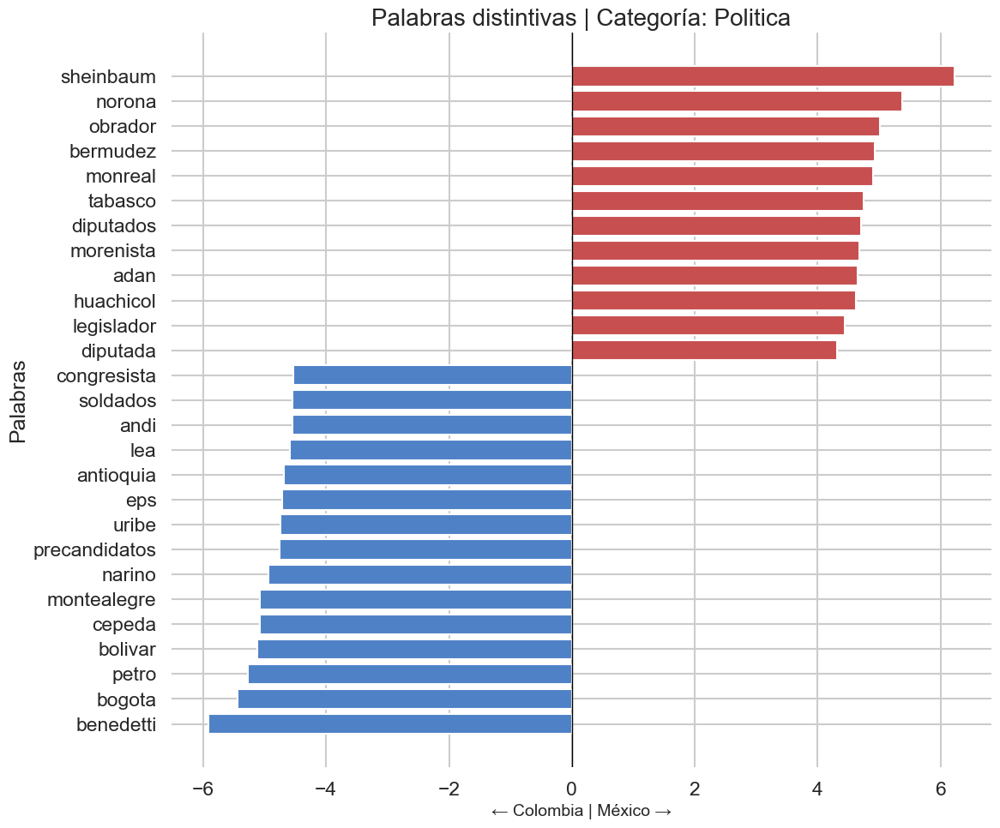

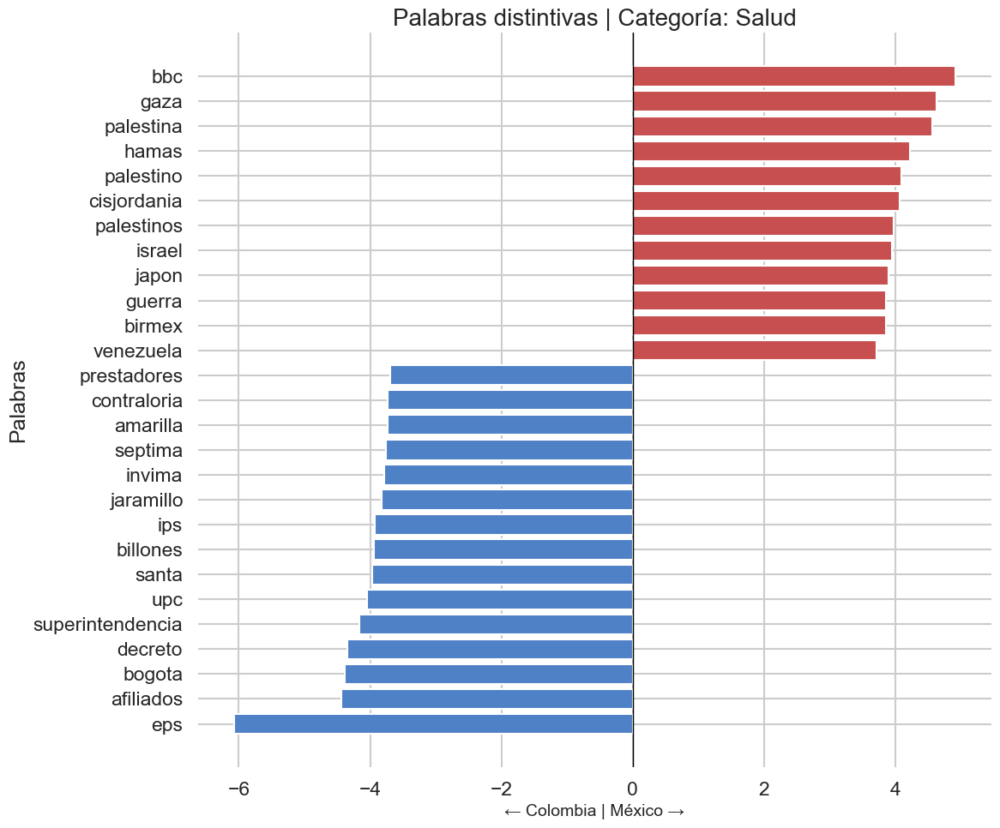

In [35]:
# Ejemplo: categoría Política
categoria = "Politica"  # coincide con la columna real
ratio_col = f"ratio_{categoria}"

top_n = 12
top_mexico = pivot.nlargest(top_n, ratio_col)
top_colombia = pivot.nsmallest(top_n, ratio_col)
combined = pd.concat([top_mexico, top_colombia]).sort_values(ratio_col)

# Limpiar palabras basura
remove_tokens = set([
    "suscribete", "suscríbete", "noticias", "newsletter", "siguenos",
    "síguenos", "facebook", "twitter", "instagram", "canal",
    "activalas", "activarlas", "activalos", "activala",
    "getty", "cuartoscuro", "foto", "fotos", "imagen", "images", "video",
    "imss", "issste", "pri", "pan", "prd", "morena"
])

def clean_word(w):
    w = str(w).lower()
    if w in remove_tokens or len(w) < 3 or any(char.isdigit() for char in w):
        return False
    return True

combined_clean = combined[combined["word"].apply(clean_word)].copy()

# Log-ratio
mex_col = f"México_{categoria}"
col_col = f"Colombia_{categoria}"

combined_clean["log_ratio"] = np.log(
    (combined_clean[mex_col] + 1) / (combined_clean[col_col] + 1)
)

# Graficar
plot_df = combined_clean
sns.set_style("whitegrid")
sns.set_context("talk")

colors = plot_df["log_ratio"].apply(lambda x: "#C74F4F" if x > 0 else "#4F81C7")

plt.figure(figsize=(12, 10))
plt.barh(plot_df["word"], plot_df["log_ratio"], color=colors)
plt.axvline(0, color="black", linewidth=1)
plt.title(f"Palabras distintivas | Categoría: {categoria}", fontsize=20)
plt.xlabel("← Colombia | México →", fontsize=14)
plt.ylabel("Palabras")
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

for ratio_col in ratio_cols:
    categoria = ratio_col.replace("ratio_", "")
    top_mexico = pivot.nlargest(15, ratio_col)
    top_colombia = pivot.nsmallest(15, ratio_col)
    combined = pd.concat([top_mexico, top_colombia]).sort_values(ratio_col)

    combined_clean = combined[combined["word"].apply(clean_word)].copy()
    mex_col = f"México_{categoria}"
    col_col = f"Colombia_{categoria}"
    combined_clean["log_ratio"] = np.log(
        (combined_clean[mex_col] + 1) / (combined_clean[col_col] + 1)
    )

    plot_df = combined_clean
    colors = plot_df["log_ratio"].apply(lambda x: "#C74F4F" if x > 0 else "#4F81C7")

    plt.figure(figsize=(12, 10))
    plt.barh(plot_df["word"], plot_df["log_ratio"], color=colors)
    plt.axvline(0, color="black", linewidth=1)
    plt.title(f"Palabras distintivas | Categoría: {categoria}", fontsize=20)
    plt.xlabel("← Colombia | México →", fontsize=14)
    plt.ylabel("Palabras")
    sns.despine(left=True, bottom=True)
    plt.tight_layout()
    plt.show()

### Paso 3.3 Reconocimiento de entidades y temas dominantes (NER + Topic Modeling)

Propósito:
Detectar las entidades nombradas y los temas principales en las noticias para comprender las diferencias semánticas y discursivas entre países y secciones, así como posibles focos temáticos que influyan en la generación de preguntas y en el rendimiento de los modelos QA.

#### Paso 3.3.1: ¿Qué entidades nombradas (PERSON, LOC, ORG, DATE, EVENT) aparecen con mayor frecuencia por país y por categoria?

##### Paso 3.3.1.1: Con spaCy

In [36]:
nlp = spacy.load("es_core_news_lg")

In [37]:
REMOVE_WORDS = {
    # Basic connectors and determiners
    "de", "del", "la", "las", "el", "los", "y", "a", "en", "al",
    "para", "por", "con", "sin", "sobre", "tras", "entre", "hacia", "hasta",
    "desde", "ante", "bajo", "según", "segun",

    # Articles and pronouns
    "un", "una", "unos", "unas", "lo", "su", "sus", "tu", "tus",
    "mi", "mis", "nuestro", "nuestra", "nuestros", "nuestras",
    "vuestro", "vuestra", "vuestros", "vuestras",
    "este", "esta", "estos", "estas", "ese", "esa", "esos", "esas",
    "aquel", "aquella", "aquellos", "aquellas", "ello",

    # Common verbs (frequent and low semantic value)
    "ser", "es", "era", "eran", "fue", "fueron", "soy", "eres", "somos", "son",
    "estar", "está", "estan", "están", "estaba", "estaban", "estuve", "estuvieron",
    "haber", "hay", "había", "habían", "he", "han", "ha", "haya", "habrá", "habrían",
    "tener", "tiene", "tienen", "tenía", "tenían", "tuvo", "tuvieron", "tendría",
    "hacer", "hace", "hacen", "hacía", "hacían", "hizo", "hicieron", "hará", "harían",
    "poder", "puede", "pueden", "podía", "podían", "podrá", "podrían", "eso"

    # Common functional words
    "que", "se", "ya", "no", "ni", "sí", "si", "tambien", "también",
    "solo", "sólo", "muy", "más", "mas", "menos", "todo", "toda", "todos", "todas",
    "nada", "algo", "algún", "alguna", "algunos", "algunas",
    "cual", "cuál", "cuales", "cuáles", "quien", "quién", "quienes", "quiénes",
    "donde", "dónde", "cuando", "cuándo", "como", "cómo",
    "porque", "porqué", "ya", "entonces", "así", "mismo", "además", "aunque",
    "pero", "sin embargo", "incluso", "también", "pues", "aun", "aún",

    # Filler and journalist/reporting words
    "lea", "lea tambien", "lea también", "según", "segun", "afirmó", "dijo",
    "indicó", "explicó", "comentó", "aseguró", "manifestó", "informó",
    "sostuvo", "declaró", "añadió", "agregó", "señaló", "destacó",
    "recordó", "resaltó", "consideró", "precisó", "recalcó",
    "dicha", "dicho", "asimismo", "finalmente", "actualmente",
    "cabe", "destaca", "afirmó", "indicó", "agregó",

    # Pronouns and reflexives
    "me", "te", "se", "nos", "os", "le", "les", "la", "lo", "las", "los",
    "él", "ella", "ellos", "ellas", "usted", "ustedes", "nosotros", "vosotros",

    # Miscellaneous and temporal words
    "yo", "tú", "usted", "él", "ella", "ellos", "ellas",
    "alguien", "cualquiera", "ninguno", "ninguna", "nunca",
    "siempre", "ahora", "ayer", "hoy", "mañana", "ahí", "aquí", "allí", "allá",
    "entonces", "mientras", "durante", "antes", "después",

    # Common noisy/filler words in scraped news text
    "siga leyendo", "según", "segun", "acuerdo", "ejemplo", "caso", "tipo", "forma",
    "vez", "veces", "parte", "lugar", "día", "días", "año", "años"
}

In [38]:
def extract_entities_spacy(text):
    """
    Extract (entity_text, entity_label) pairs from Spanish text,
    keeping original casing for model use.
    """
    doc = nlp(text)
    entities = []
    for ent in doc.ents:
        ent_text = ent.text.strip()
        words = [w.strip(string.punctuation).lower() for w in ent_text.split()]
        if len(words) == 0 or all(word in STOP_WORDS for word in words):
            continue
        if len(ent_text) <= 3:
            continue
        # Keep original text (with case)
        entities.append((ent.text.strip(), ent.label_))
    return entities


In [39]:
def clean_entities(entities):
    """
    Cleans entity text but preserves (text, label) structure.
    """
    cleaned = []
    for text, label in entities:
        words = [w for w in text.split() if w.lower() not in REMOVE_WORDS]
        new_text = " ".join(words).strip()
        if new_text:
            cleaned.append((new_text, label))   # <-- keep label
    return cleaned


In [40]:
def extract_entities_spacy(text):
    doc = nlp(text)
    return [(ent.text, ent.label_) for ent in doc.ents]


In [41]:
df["content_removed_unwanted_elements"].head(3).apply(lambda x: type(x))


0    <class 'str'>
1    <class 'str'>
2    <class 'str'>
Name: content_removed_unwanted_elements, dtype: object

In [42]:
# Apply extraction + cleaning
df["entities"] = df["content_removed_unwanted_elements"].apply(
    lambda text: clean_entities(extract_entities_spacy(text)) if isinstance(text, str) else []
)

In [43]:
df["entities"]

0       [(Gabo, PER), (Gabriel Garcia Marquez, PER), (...
1       [(Tiburon, ORG), (National Geographic, ORG), (...
2       [(Decadas, PER), (Argentina, LOC), (Chile, LOC...
3       [(Simon Mesa Soto, PER), (Cierta Mirada Festiv...
4       [(Sera, MISC), (domingo, MISC), (Feria Interna...
                              ...                        
4324    [(Asociacion Espanola Pediatria, MISC), (AEP, ...
4325    [(UE, ORG), (Union Europea, ORG), (accion rapi...
4326    [(Asi: cazarlas eso depende vida hijo, MISC), ...
4327    [(equipo neurologa, MISC), (Emma Macdonald Lau...
4328    [(Fundacion Huesped, ORG), (proposito, MISC), ...
Name: entities, Length: 4329, dtype: object

In [44]:

# 1. --- Filter the DataFrame for Mexico AND Judicial Category ---
# IMPORTANT: Replace 'category_column_name' with the actual name of your category column (e.g., 'category')
# IMPORTANT: Use the exact string for the country and category (e.g., 'México' and 'Judicial')
df_mexico_judicial = df[
    (df['country'] == 'México') &
    (df['category'] == 'Judicial')
].copy()

print(f"Total articles in the 'Mexico - Judicial' slice: {len(df_mexico_judicial)}")

# 2. --- Create a Boolean Mask to Identify Bogotá Mentions ---
bogota_mask = df_mexico_judicial["content"].str.contains(
    'bogota|bogotá',   # Search for 'bogota' or 'bogotá' (case-insensitive)
    case=False,        # Ignore case
    na=False
)

# 3. --- Filter the Judicial DataFrame using the Bogotá Mask ---
df_bogota_articles = df_mexico_judicial[bogota_mask]

# 4. --- Display the Relevant Information ---
print(f"Total articles mentioning Bogotá in the Mexico-Judicial corpus: {len(df_bogota_articles)}")
print("\nTitles and Content Snippets of Bogotá-Related Articles in Mexican Judicial News:")

# Display the title and a snippet of the content for the first 5 articles
for index, row in df_bogota_articles[['title', 'content']].head(5).iterrows():
    print("---")
    print(f"TITLE: {row['title']}")

    # Get a 200-character snippet of the content
    content_snippet = row['content'][:200].replace('\n', ' ')
    print(f"CONTENT SNIPPET: {content_snippet}...")

Total articles in the 'Mexico - Judicial' slice: 0
Total articles mentioning Bogotá in the Mexico-Judicial corpus: 0

Titles and Content Snippets of Bogotá-Related Articles in Mexican Judicial News:


In [45]:
entity_rows = []

for _, row in df.iterrows():
    ents = row["entities"]
    if not isinstance(ents, list):
        continue

    for (ent_text, ent_label) in ents:
        entity_rows.append({
            "country": row["country"],
            "category": row["category"],
            "entity": ent_text.strip(),
            "type": ent_label.strip()
        })

entity_df = pd.DataFrame(entity_rows)


In [46]:
df_filtered = df[
    (df["category"].str.contains("judicial", case=False, na=False)) &
    (df["country"].str.lower() == "méxico")
][["content_lemmes", "country", "category"]]

df_filtered.head()


,content_lemmes,country,category


In [47]:
# --- 3. Calcular frecuencia de cada entidad ---
entity_freq = (
    entity_df.groupby(["country", "category", "type", "entity"])
    .size()
    .reset_index(name="frequency")
)


In [48]:
# --- 4. Seleccionar las 30 más frecuentes por país y sección ---
top_entities = (
    entity_freq.groupby(["country", "category", "type"], group_keys=False)
    .apply(lambda x: x.nlargest(30, "frequency"))
    .reset_index(drop=True)
)

C:\Users\guill\AppData\Local\Temp\ipykernel_40588\3759326587.py:4: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(30, "frequency"))


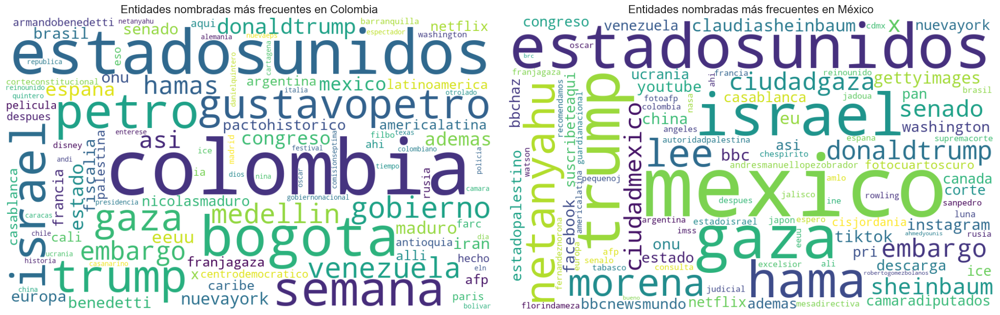

In [49]:
# Define the two countries to compare
countries = ["Colombia", "México"]

# Words to remove (normalized lowercase)
stop_entities = {"ano", "año", "años", "unido", "unidos", "unida", "unidas", "nino"}

# Prepare a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

for ax, country in zip(axes, countries):
    # Extract entity texts
    entities_texts = df[df["country"] == country]["entities"].explode().dropna()
    entities_texts = [ent[0].lower() for ent in entities_texts if isinstance(ent, tuple)]

    # Clean punctuation and accents before filtering
    cleaned_entities = []
    for e in entities_texts:
        e = re.sub(r"[^\wáéíóúñü]", "", e.lower())  # remove punctuation, keep letters
        if e not in stop_entities:
            cleaned_entities.append(e)

    # Skip if no entities found
    if len(cleaned_entities) == 0:
        ax.set_title(f"{country} – sin datos")
        ax.axis("off")
        continue

    # Generate word cloud
    text = " ".join(cleaned_entities)
    wc = WordCloud(
        width=1000,
        height=600,
        background_color="white",
        max_words=100,
        collocations=False
    ).generate(text)

    # Display side-by-side
    ax.imshow(wc, interpolation="bilinear")
    ax.axis("off")
    ax.set_title(f"Entidades nombradas más frecuentes en {country}", fontsize=16)

plt.tight_layout()
plt.show()

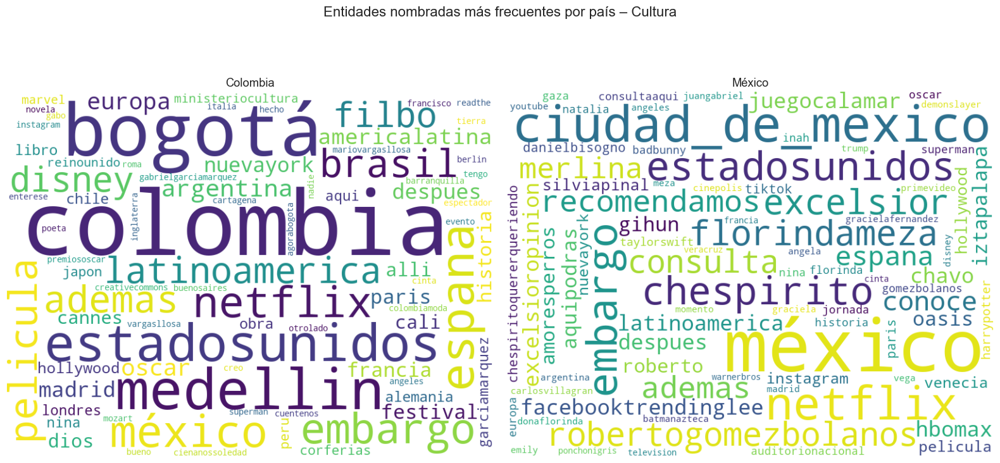

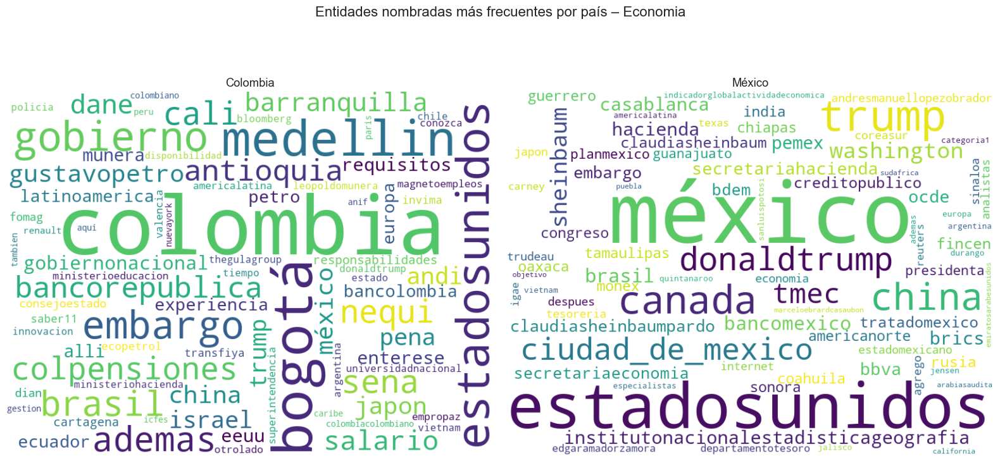

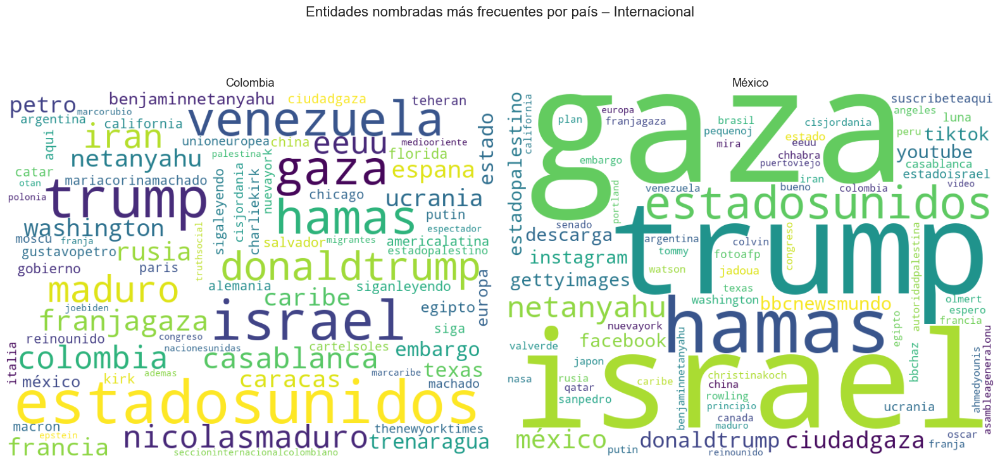

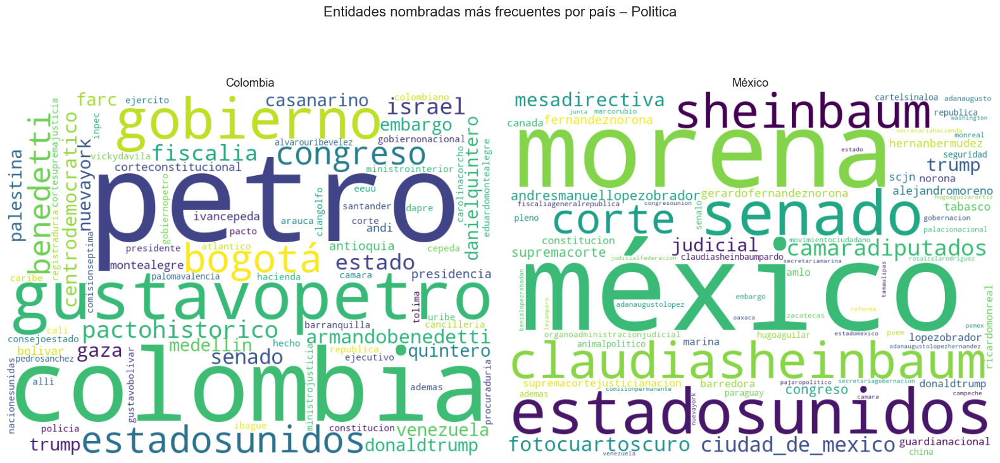

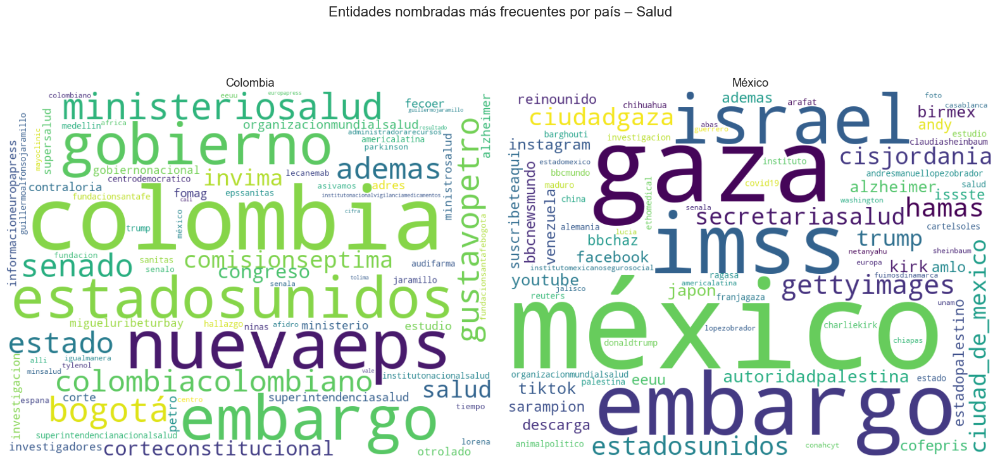

In [148]:
countries = ["Colombia", "México"]  # adjust if spelling differs

# Words/entities to remove (lowercase + normalized)
stop_entities = {
    "ano", "año", "años", "unido", "unidos", "unida", "unidas",
    "nino", "semana", "persona", "personaje", "familia",
    "ficcion", "serie", "capitulo"
}

# Normalization map for noisy variants
normalization_map = {
    "ciudadmexico": "ciudad_de_mexico",
    "cdmx": "ciudad_de_mexico",
    "bogota": "bogotá",
    "mexico": "méxico",
}

def normalize_entity(e):
    e = e.lower()
    e = re.sub(r"[^\wáéíóúñü]", "", e)  # keep Spanish chars
    if len(e) <= 3:
        return ""                     # avoid noise
    return normalization_map.get(e, e)

for category in df["category"].unique():
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(f"Entidades nombradas más frecuentes por país – {category}", fontsize=16)

    for i, country in enumerate(countries):
        subset = df[(df["country"] == country) & (df["category"] == category)]
        entities = subset["entities"].explode().dropna()
        entities = [ent[0] for ent in entities if isinstance(ent, tuple)]

        # Normalize text
        entities = [normalize_entity(e) for e in entities]
        entities = [e for e in entities if e and e not in stop_entities]

        # Filter by frequency (min 3 appearances)
        freq = pd.Series(entities).value_counts()
        freq = freq[freq >= 3]

        if freq.empty:
            axes[i].axis("off")
            axes[i].set_title(f"{country} – sin datos")
            continue

        # Generate cleaned cloud
        text = " ".join(freq.index.repeat(freq.values))
        wc = WordCloud(
            width=800,
            height=600,
            background_color="white",
            max_words=80,
            collocations=False,
            prefer_horizontal=0.9
        ).generate(text)

        axes[i].imshow(wc, interpolation="bilinear")
        axes[i].axis("off")
        axes[i].set_title(f"{country}")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


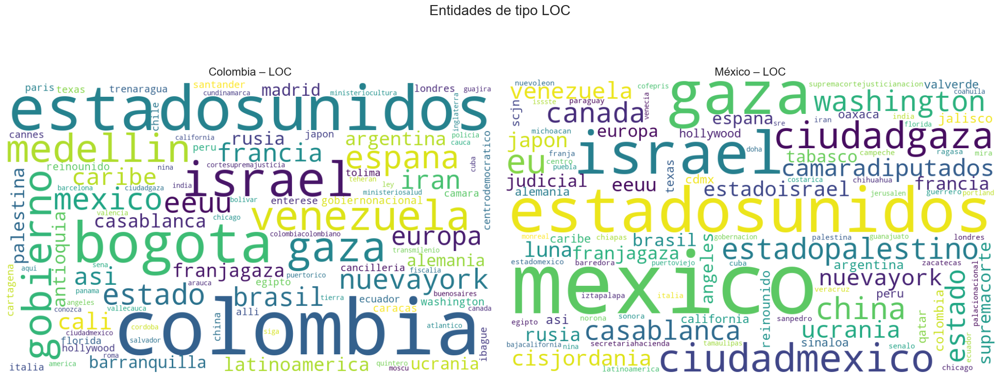

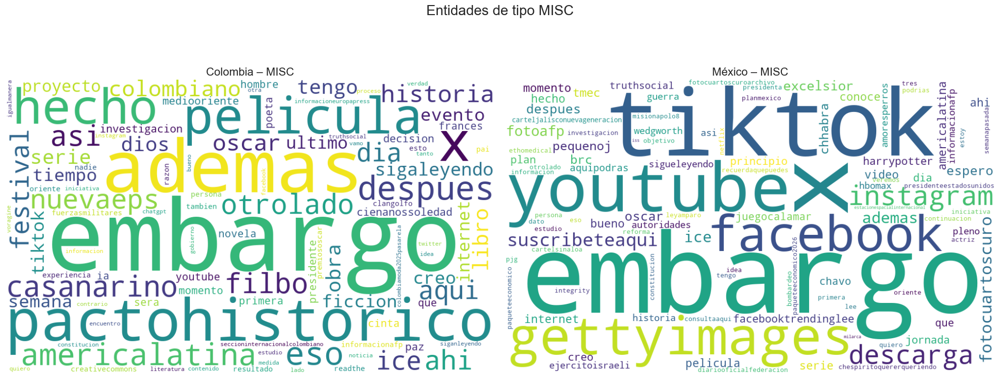

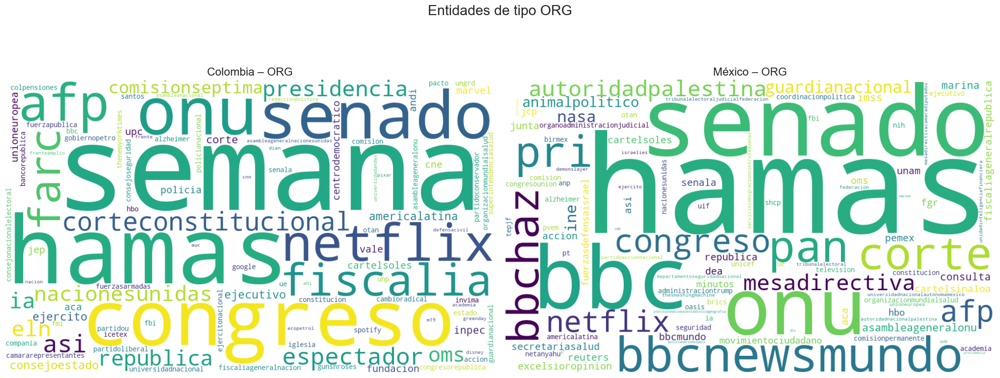

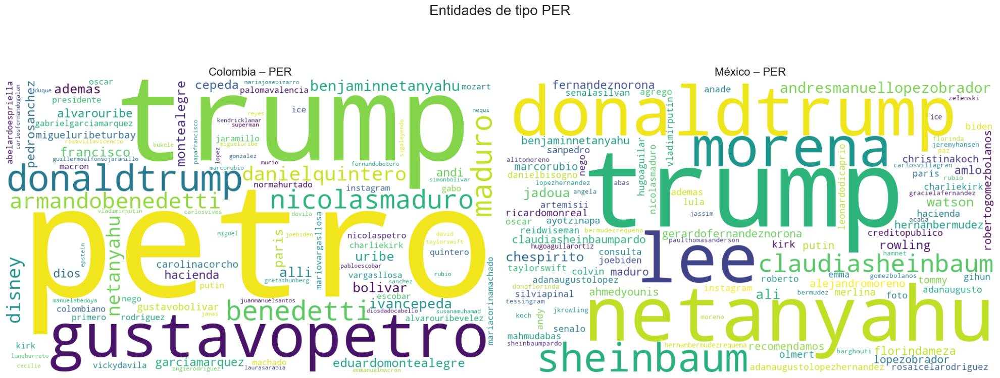

In [149]:
import re
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Get all unique entity types across both countries
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

countries = ["Colombia", "México"]

# Words to remove (normalized lowercase)
stop_entities = {"ano", "año", "años", "unido", "unidos", "unida", "unidas", "nino"}

# Loop over entity types
for entity_type in entity_types:
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))

    for ax, country in zip(axes, countries):
        # Extract entities of this type for each country
        entities_texts = df[df["country"] == country]["entities"].explode().dropna()
        entities_texts = [
            ent[0].lower()
            for ent in entities_texts
            if isinstance(ent, tuple) and ent[1] == entity_type
        ]

        # Clean and filter
        cleaned_entities = []
        for e in entities_texts:
            # Remove punctuation but keep Spanish characters
            e = re.sub(r"[^\wáéíóúñü]", "", e.lower())
            if e not in stop_entities:
                cleaned_entities.append(e)

        # Skip if none
        if len(cleaned_entities) == 0:
            ax.set_title(f"{country} – sin datos", fontsize=14)
            ax.axis("off")
            continue

        # Generate WordCloud
        text = " ".join(cleaned_entities)
        wc = WordCloud(
            width=1000,
            height=600,
            background_color="white",
            max_words=100,
            collocations=False
        ).generate(text)

        ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(f"{country} – {entity_type}", fontsize=16)

    fig.suptitle(f"Entidades de tipo {entity_type}", fontsize=20, y=1.02)
    plt.tight_layout()
    plt.show()



=== CULTURA ===


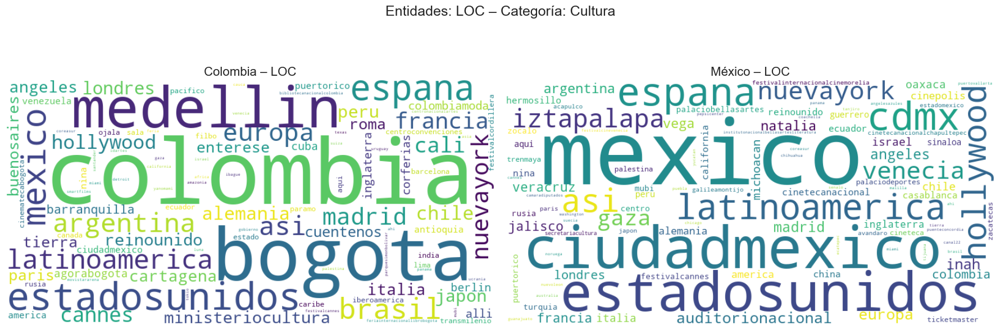

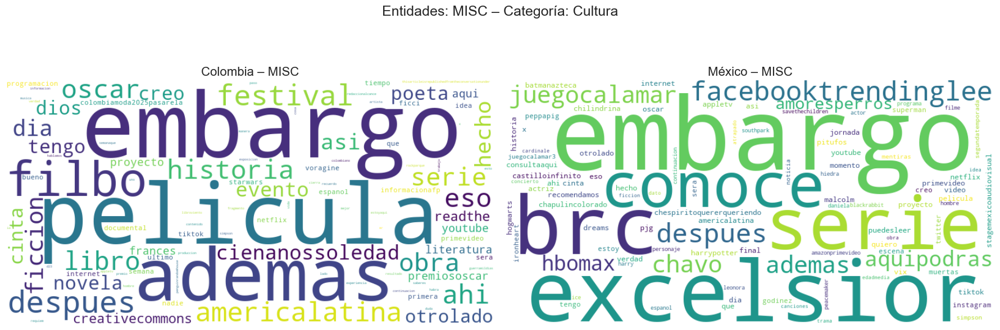

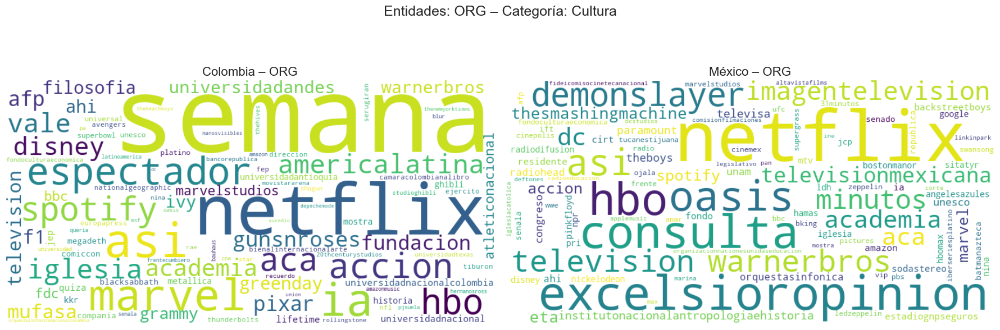

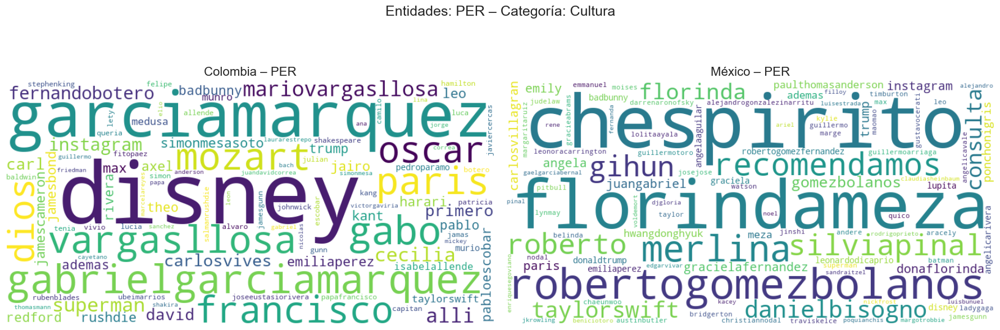

=== ECONOMIA ===


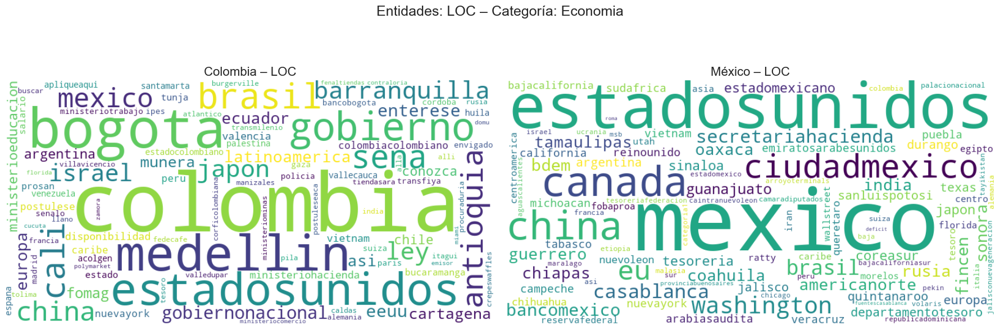

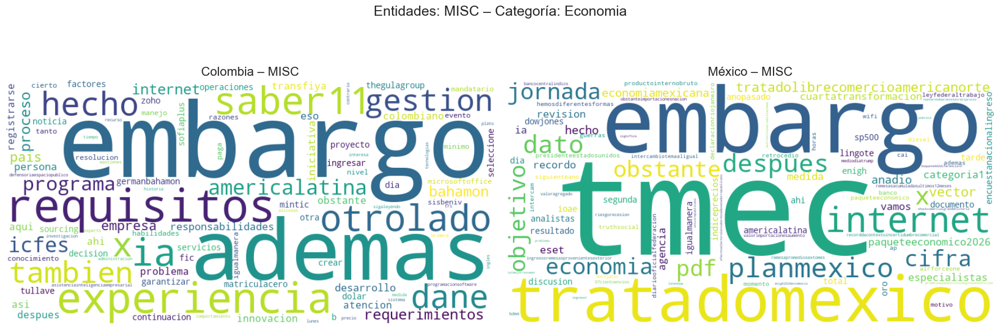

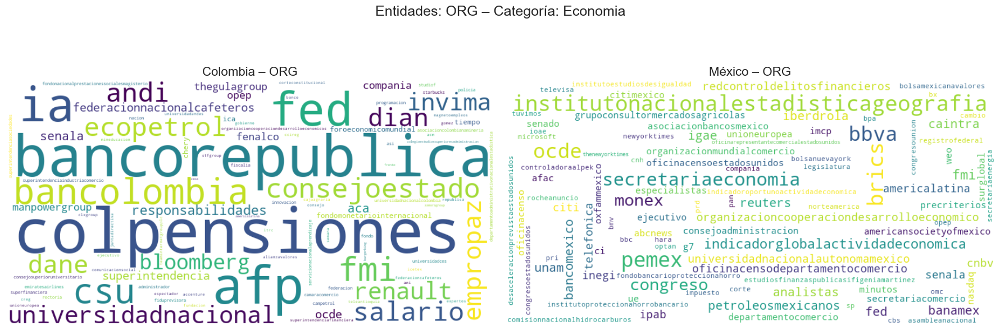

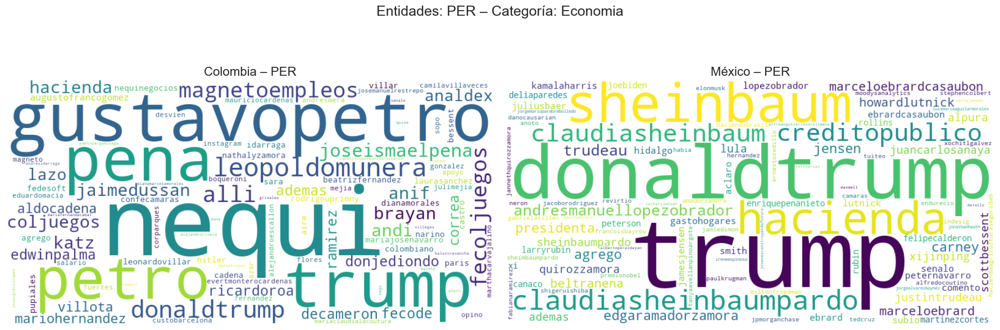

=== INTERNACIONAL ===


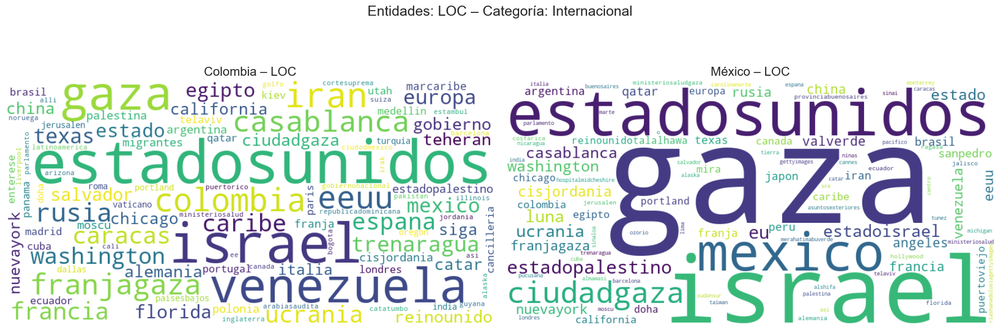

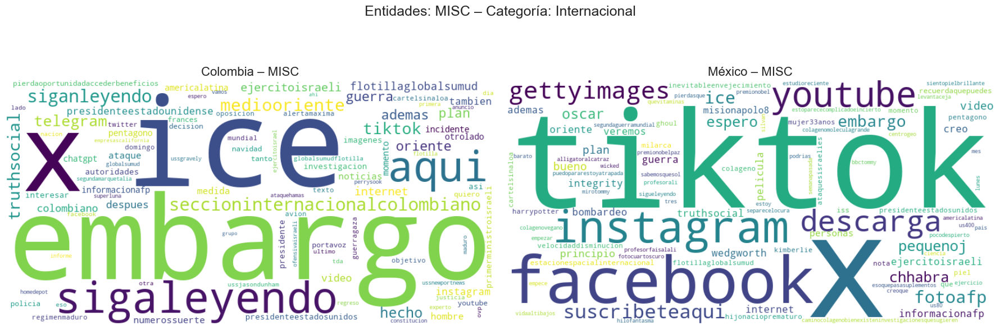

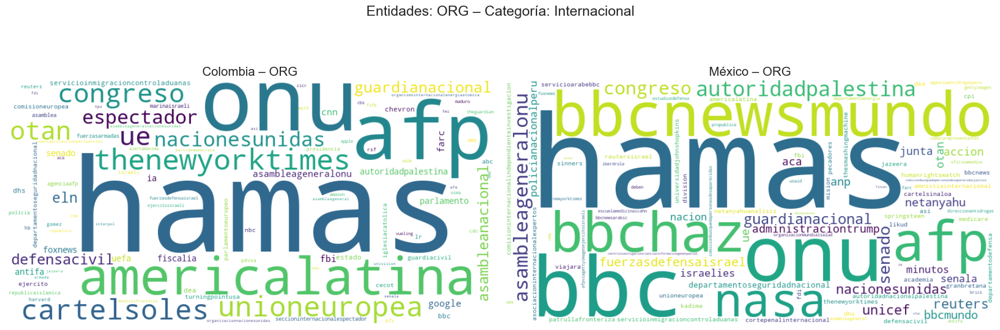

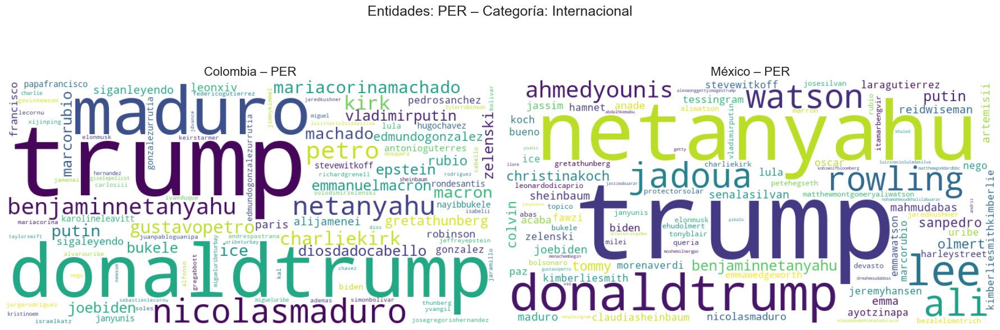

=== POLITICA ===


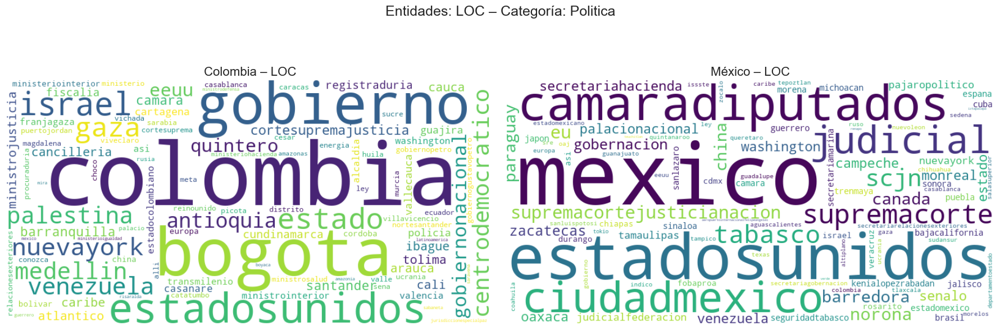

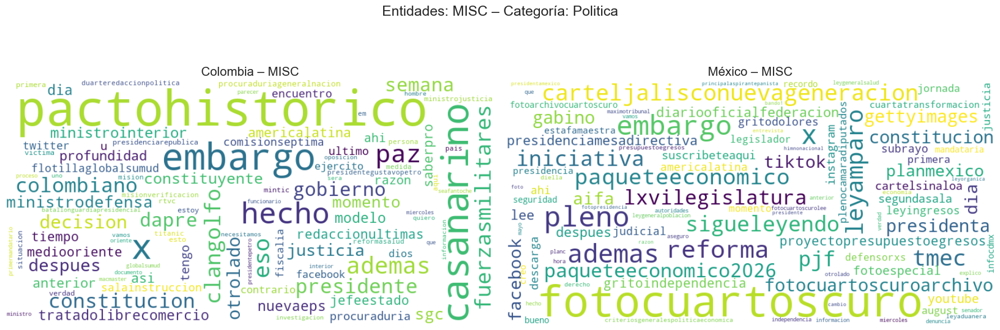

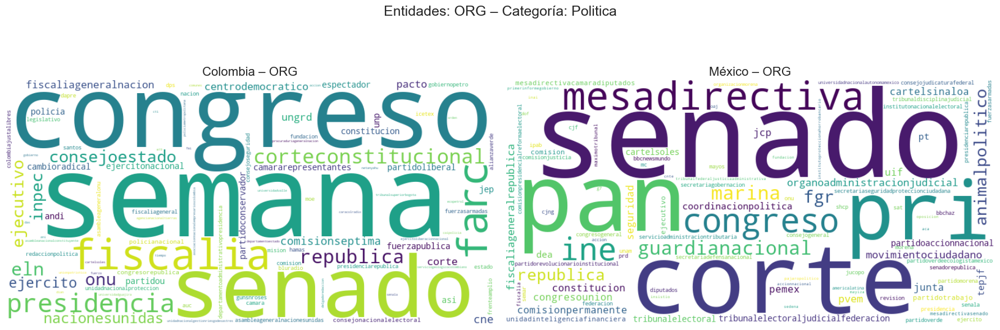

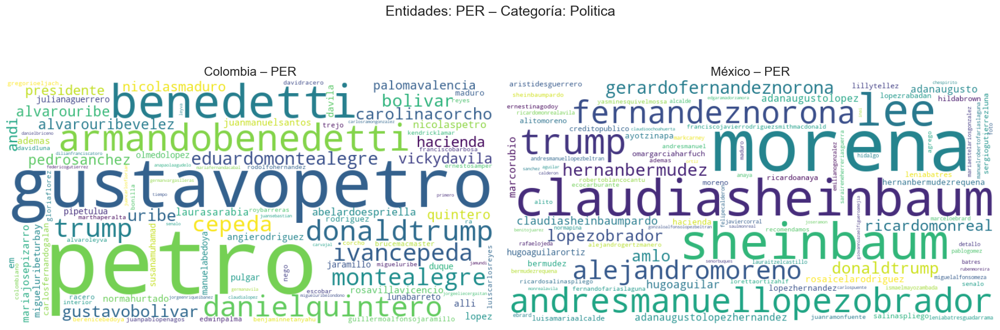

=== SALUD ===


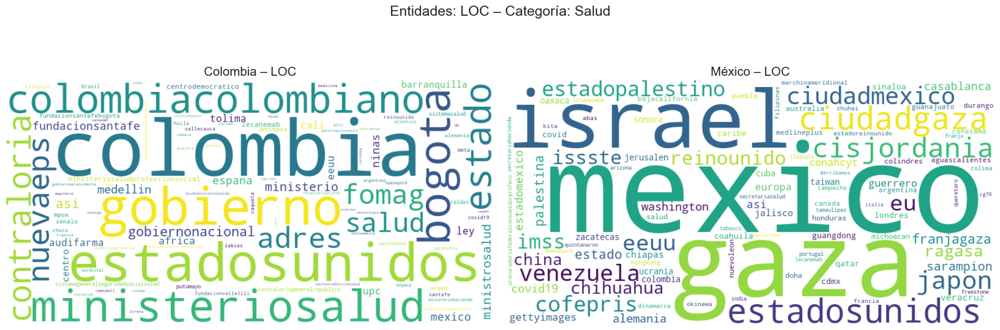

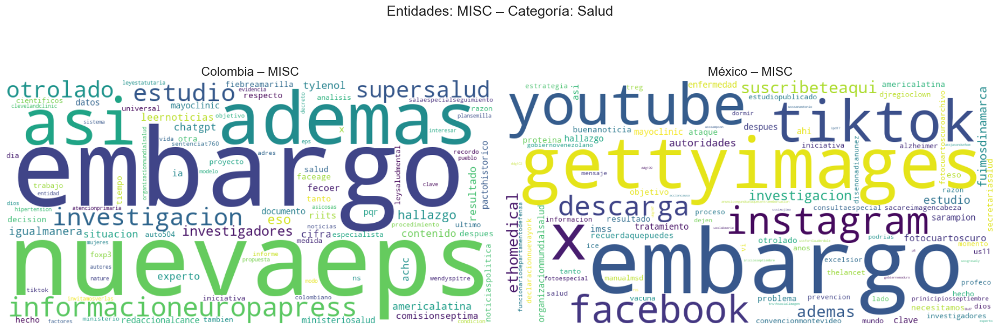

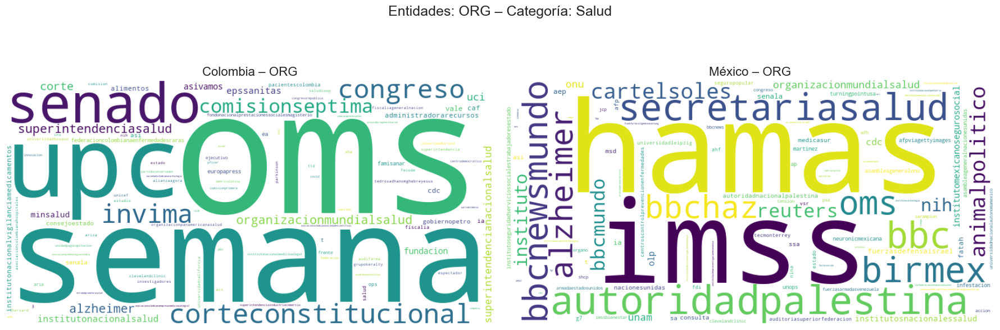

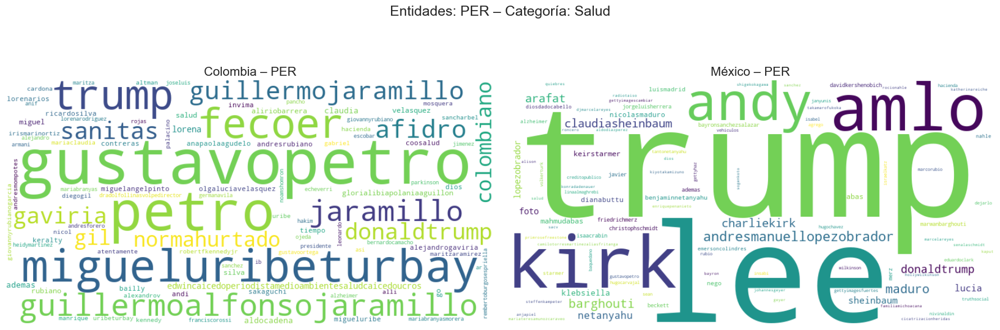

In [152]:
countries = ["Colombia", "México"]

# Words to remove (normalized lowercase)
stop_entities = {"ano", "año", "años", "unido", "unidos", "unida", "unidas", "nino"}

# Get all unique entity types across both countries
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

# Loop over categories
for category in df["category"].unique():
    print(f"=== {category.upper()} ===")

    for entity_type in entity_types:

        # Crear una figura SOLO para este tipo de entidad
        fig, axes = plt.subplots(1, 2, figsize=(18, 6))

        any_data = False  # para detectar si ambos países están vacíos

        for j, country in enumerate(countries):

            ax = axes[j]

            subset = df[(df["country"] == country) & (df["category"] == category)]
            entities_texts = subset["entities"].explode().dropna()

            entities_texts = [
                ent[0].lower()
                for ent in entities_texts
                if isinstance(ent, tuple) and ent[1] == entity_type
            ]

            # Clean punctuation and filter stop words
            cleaned_entities = []
            for e in entities_texts:
                e = re.sub(r"[^\wáéíóúñü]", "", e.lower())
                if e not in stop_entities:
                    cleaned_entities.append(e)

            if len(cleaned_entities) == 0:
                ax.set_title(f"{country} – {entity_type}: sin datos", fontsize=14)
                ax.axis("off")
                continue

            any_data = True

            # Generate WordCloud
            text = " ".join(cleaned_entities)
            wc = WordCloud(
                width=800,
                height=400,
                background_color="white",
                max_words=100,
                collocations=False
            ).generate(text)

            ax.imshow(wc, interpolation="bilinear")
            ax.axis("off")
            ax.set_title(f"{country} – {entity_type}", fontsize=16)

        if any_data:
            fig.suptitle(f"Entidades: {entity_type} – Categoría: {category}", fontsize=18, y=1.05)
            plt.tight_layout()
            plt.show()
        else:
            plt.close(fig)  # si los dos están vacíos, no se muestra



#### Paso 3.3.2: ¿Qué entidades son exclusivas de cada país o comparten ambos?

In [48]:
# Aseguramos que 'entities' tenga formato [(texto, tipo), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Agrupamos entidades por país y tipo
entities_by_country = (
    df_entities.groupby(["country", "entity_type"])["entity_text"]
    .apply(lambda x: set(map(str.lower, x.dropna())))
    .reset_index()
)

# Unimos Colombia y México por tipo de entidad
merged = entities_by_country.pivot(index="entity_type", columns="country", values="entity_text")

# Reemplazamos NaN con conjuntos vacíos
merged = merged.applymap(lambda x: x if isinstance(x, set) else set())

# Calculamos exclusivas y compartidas
results = []
for entity_type, row in merged.iterrows():
    colombia_ents = row.get("Colombia", set())
    mexico_ents = row.get("México", set())

    exclusivas_col = colombia_ents - mexico_ents
    exclusivas_mex = mexico_ents - colombia_ents
    compartidas = colombia_ents & mexico_ents

    results.append({
        "entity_type": entity_type,
        "exclusivas_colombia": list(exclusivas_col)[:15],  # top 15
        "exclusivas_mexico": list(exclusivas_mex)[:15],
        "compartidas": list(compartidas)[:15]
    })

exclusive_df = pd.DataFrame(results)
exclusive_df

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3689353077.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  merged = merged.applymap(lambda x: x if isinstance(x, set) else set())


,entity_type,exclusivas_colombia,exclusivas_mexico,compartidas
0,LOC,"[fenomeno nino, santa barbara, novgorod, ibaga...","[mexico mexico responderar, bebes, san diego c...","[mediacion egipto, urgio, brasilén, teatro sca..."
1,MISC,"[boeing poseidon, blue ivy carter, registrir, ...","[iran b hama c, embajadoro mexico chile alicia...","[uss lake erie, fiscalio momento, cop millón, ..."
2,ORG,"[bogota fashion week internacionalizacion, uni...","[movimiento politico unido, partido verde jose...","[dfs, unia solidaridad internacional defensa d..."
3,PER,"[gabriel enrique castilla castillo, camilo orb...","[gilberto batiz claudia valle aguilasocho, qui...","[dea, lena, francoargelín helenir, polvoro bar..."


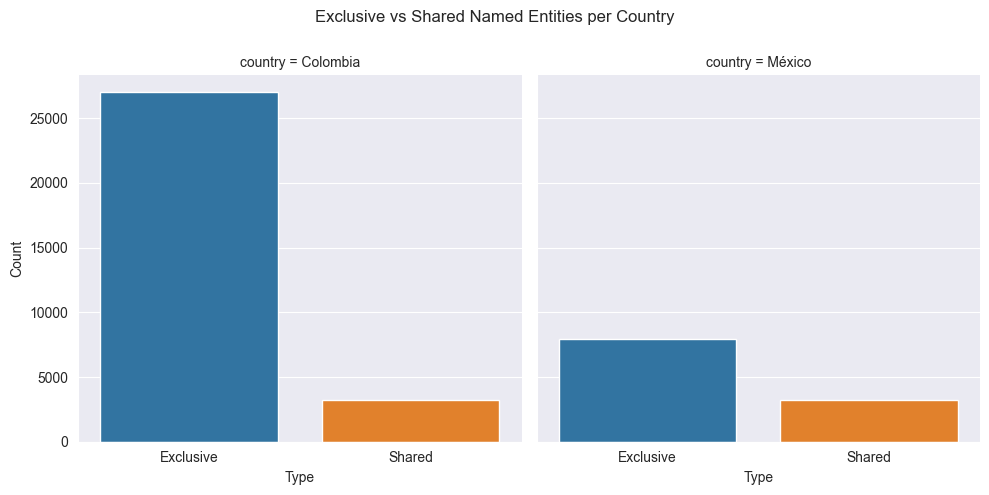

In [49]:
# Compute exclusive/shared entities per country
col_entities = set(
    ent[0].lower() for ent in df[df["country"]=="Colombia"]["entities"].explode()
    if isinstance(ent, tuple)
)
mex_entities = set(
    ent[0].lower() for ent in df[df["country"]=="México"]["entities"].explode()
    if isinstance(ent, tuple)
)

# Prepare DataFrame
plot_df = pd.DataFrame([
    {"country": "Colombia", "Type": "Exclusive", "Count": len(col_entities - mex_entities)},
    {"country": "Colombia", "Type": "Shared", "Count": len(col_entities & mex_entities)},
    {"country": "México", "Type": "Exclusive", "Count": len(mex_entities - col_entities)},
    {"country": "México", "Type": "Shared", "Count": len(col_entities & mex_entities)}
])

# Plot
sns.catplot(
    data=plot_df,
    x="Type", y="Count",
    hue="Type", col="country",
    kind="bar", dodge=False,
    height=5, sharey=True
)
plt.subplots_adjust(top=0.85)
plt.suptitle("Exclusive vs Shared Named Entities per Country")
plt.show()


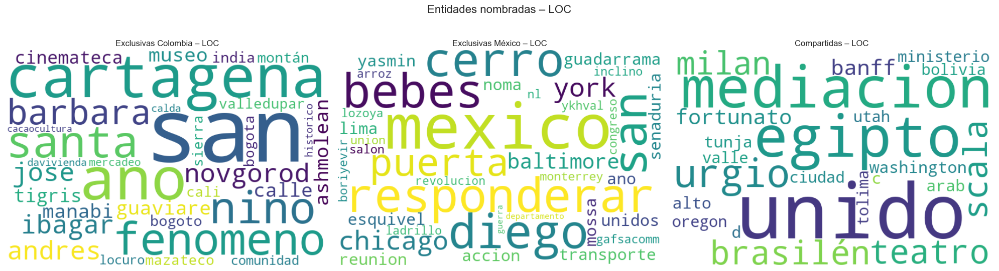

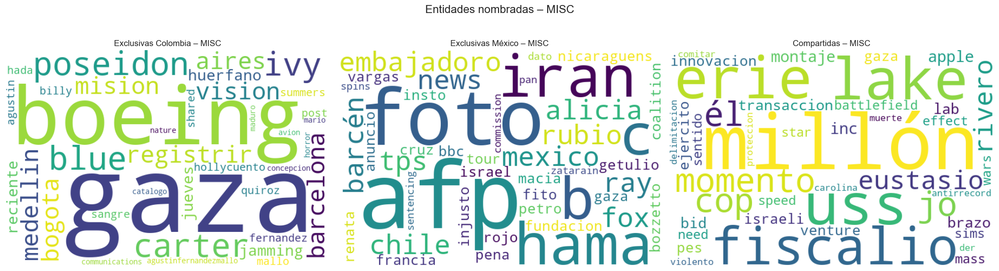

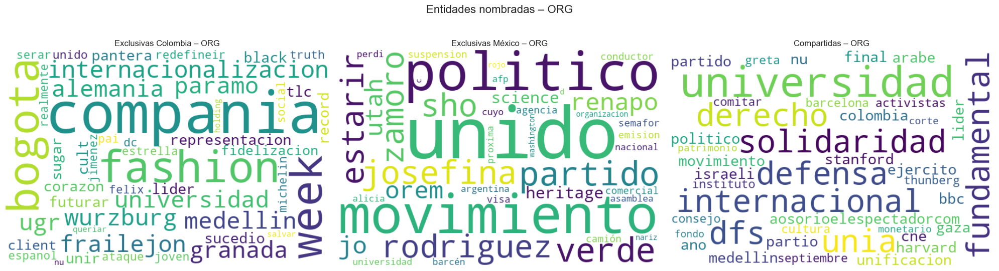

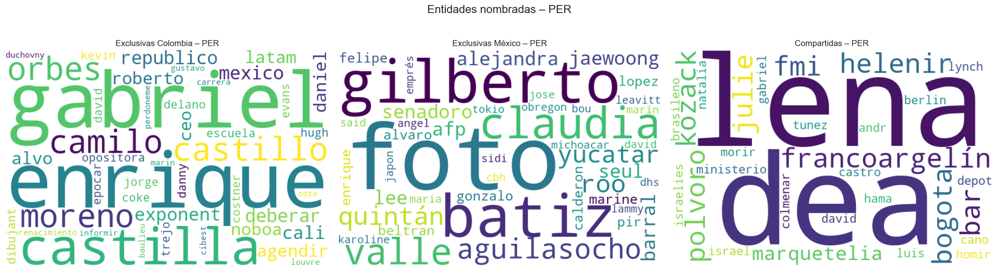

In [50]:
# Loop over each entity type
for idx, row in exclusive_df.iterrows():
    entity_type = row["entity_type"]
    colombia_text = " ".join(row["exclusivas_colombia"])
    mexico_text = " ".join(row["exclusivas_mexico"])
    shared_text = " ".join(row["compartidas"])

    # Create a figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # Colombia exclusive
    wc_col = WordCloud(width=600, height=400, background_color="white").generate(colombia_text)
    axes[0].imshow(wc_col, interpolation="bilinear")
    axes[0].axis("off")
    axes[0].set_title(f"Exclusivas Colombia – {entity_type}")

    # Mexico exclusive
    wc_mex = WordCloud(width=600, height=400, background_color="white").generate(mexico_text)
    axes[1].imshow(wc_mex, interpolation="bilinear")
    axes[1].axis("off")
    axes[1].set_title(f"Exclusivas México – {entity_type}")

    # Shared
    wc_shared = WordCloud(width=600, height=400, background_color="white").generate(shared_text)
    axes[2].imshow(wc_shared, interpolation="bilinear")
    axes[2].axis("off")
    axes[2].set_title(f"Compartidas – {entity_type}")

    plt.suptitle(f"Entidades nombradas – {entity_type}", fontsize=16)
    plt.tight_layout()
    plt.show()

In [51]:
# Extract sets of entities per country
entities_col = set([ent[0] for ents in df[df["country"]=="Colombia"]["entities"] if isinstance(ents, list) for ent in ents])
entities_mex = set([ent[0] for ents in df[df["country"]=="México"]["entities"] if isinstance(ents, list) for ent in ents])

# Entities exclusive to each country
exclusive_col = entities_col - entities_mex
exclusive_mex = entities_mex - entities_col

# Entities shared by both
shared_entities = entities_col & entities_mex

print(f"Exclusive to Colombia: {len(exclusive_col)} entities")
print(f"Exclusive to México: {len(exclusive_mex)} entities")
print(f"Shared: {len(shared_entities)} entities")



Exclusive to Colombia: 26984 entities
Exclusive to México: 7936 entities
Shared: 3250 entities


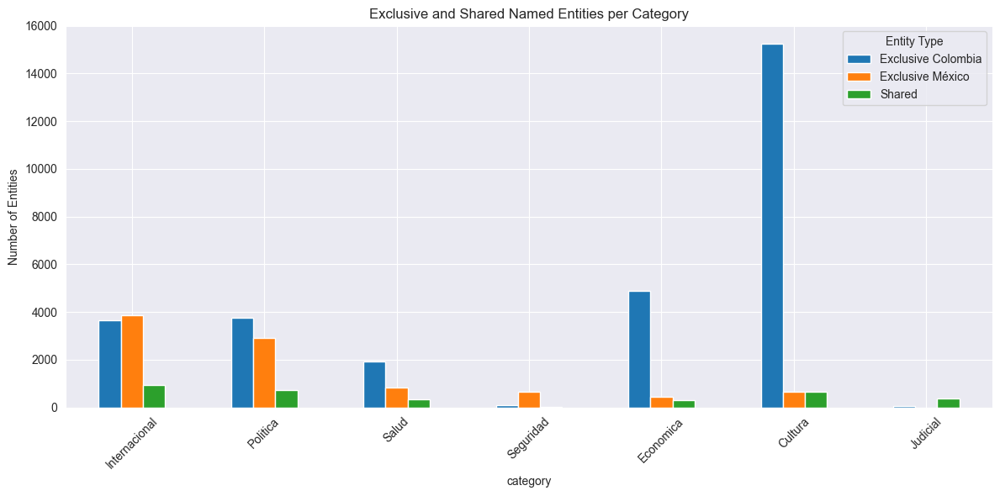

In [52]:
# Prepare a DataFrame to store counts
rows = []

for category in df["category"].unique():
    col_entities = set(
        [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    mex_entities = set(
        [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    exclusive_col = col_entities - mex_entities
    exclusive_mex = mex_entities - col_entities
    shared = col_entities & mex_entities

    rows.append({
        "category": category,
        "Exclusive Colombia": len(exclusive_col),
        "Exclusive México": len(exclusive_mex),
        "Shared": len(shared)
    })

plot_df = pd.DataFrame(rows)

# Plot
plot_df.set_index("category").plot(kind="bar", figsize=(12,6))
plt.ylabel("Number of Entities")
plt.title("Exclusive and Shared Named Entities per Category")
plt.xticks(rotation=45)
plt.legend(title="Entity Type")
plt.tight_layout()
plt.show()

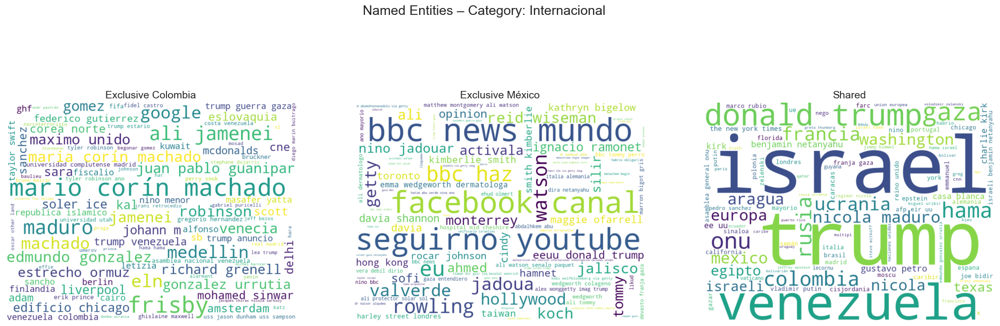

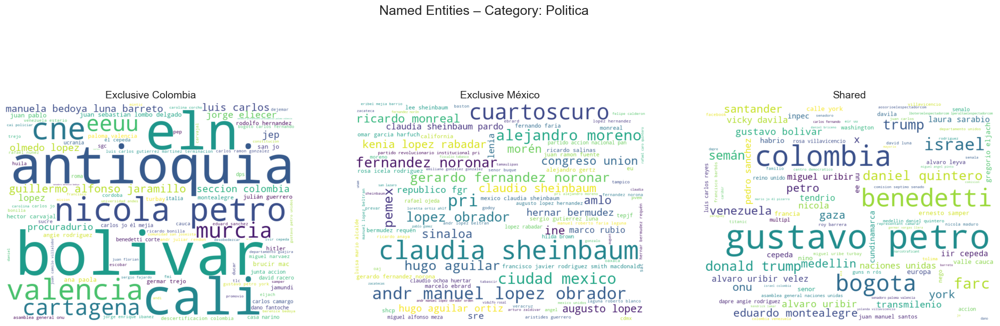

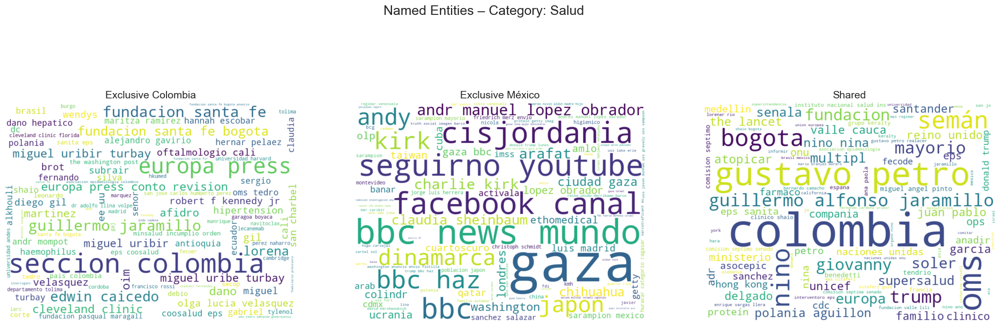

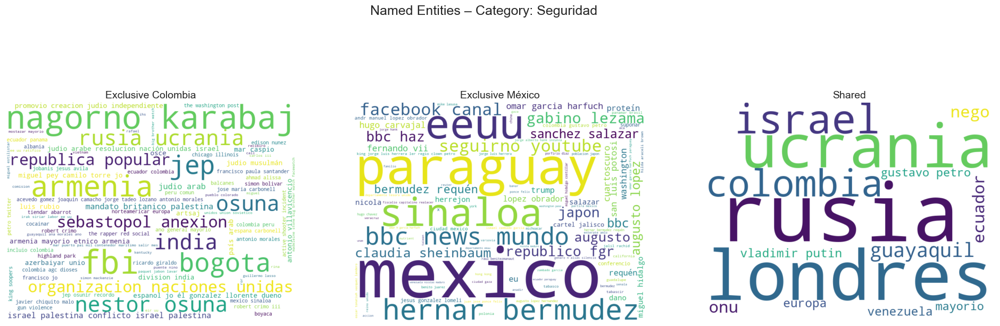

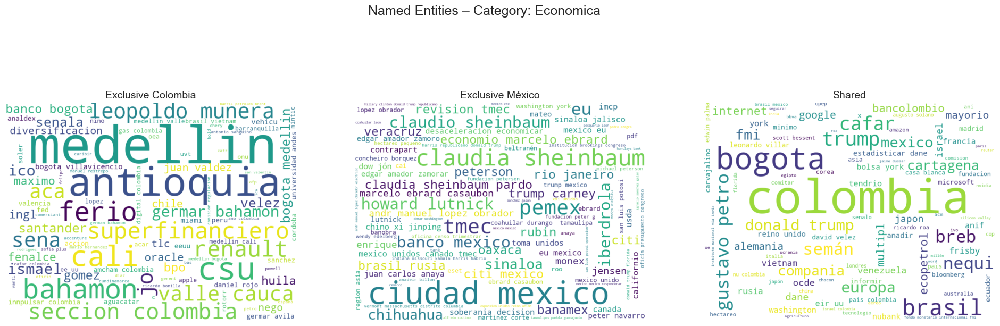

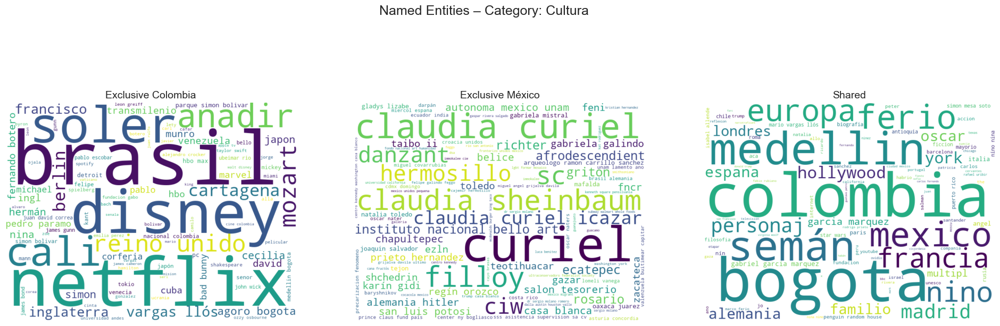

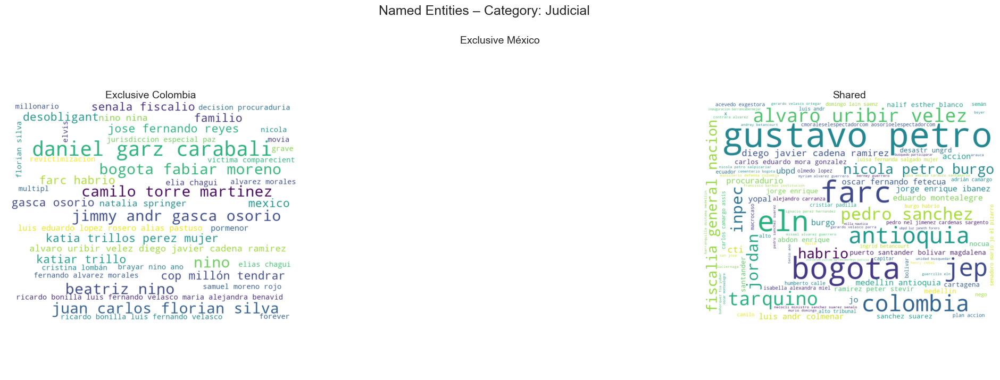

In [53]:
for category in df["category"].unique():
    # Get all entities per country
    col_entities = [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]
    mex_entities = [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]

    # Count frequencies
    col_counter = Counter(col_entities)
    mex_counter = Counter(mex_entities)

    # Exclusive and shared entities with frequencies
    exclusive_col = {k:v for k,v in col_counter.items() if k not in mex_counter}
    exclusive_mex = {k:v for k,v in mex_counter.items() if k not in col_counter}
    shared = {k:v for k,v in col_counter.items() if k in mex_counter}

    # Create figure
    fig, axes = plt.subplots(1, 3, figsize=(24,8))
    fig.suptitle(f"Named Entities – Category: {category}", fontsize=18)

    # Word clouds
    for ax, data, title in zip(axes, [exclusive_col, exclusive_mex, shared],
                               ["Exclusive Colombia", "Exclusive México", "Shared"]):
        if data:  # Only generate if there is data
            wc = WordCloud(width=800, height=600, background_color="white", max_words=100, collocations=False)
            wc.generate_from_frequencies(data)
            ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(title, fontsize=14)

    plt.show()

#### Paso 3.3.3: ¿Qué temas predominan?

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\719633996.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


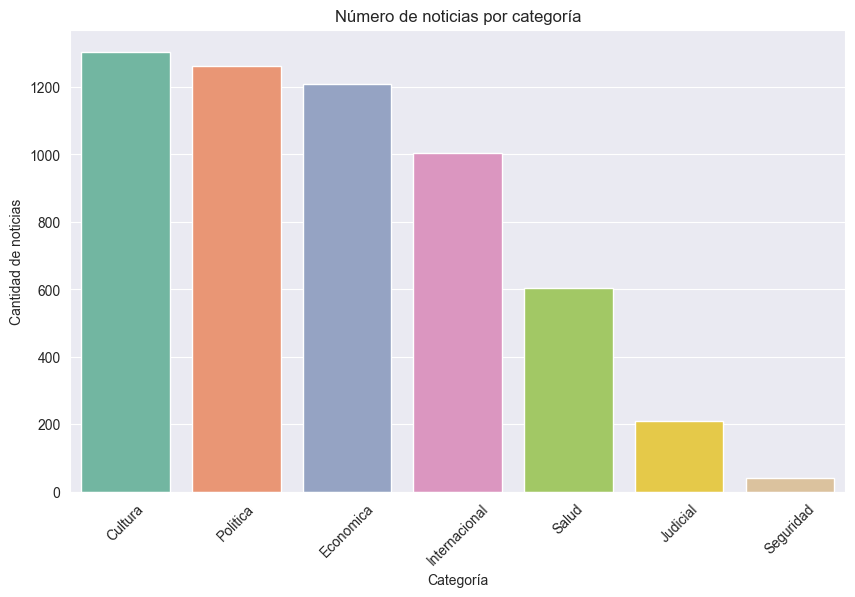

In [54]:
# Count texts per category
category_counts = df["category"].value_counts().reset_index()
category_counts.columns = ["category", "count"]

# Plot
plt.figure(figsize=(10,6))
sns.barplot(
    data=category_counts.sort_values("count", ascending=False),
    x="category",
    y="count",
    palette="Set2"
)
plt.title("Número de noticias por categoría")
plt.xlabel("Categoría")
plt.ylabel("Cantidad de noticias")
plt.xticks(rotation=45)
plt.show()

#### Paso 3.3.4: ¿Cómo varía la densidad de entidades por categoria o medio?

In [55]:
# Ensure content_tokens are lists of words
df["content_tokens"] = df["content_tokens"].apply(lambda x: x.split() if isinstance(x, str) else [])

# Ensure entities column is a list
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Compute number of entities and tokens
df["num_entities"] = df["entities"].apply(len)
df["num_tokens"] = df["content_tokens"].apply(len)

In [56]:
# Compute entity density safely
df["entity_density"] = df.apply(
    lambda row: row["num_entities"] / row["num_tokens"] if row["num_tokens"] > 0 else 0, axis=1
)

# Quick check
df[["num_entities", "num_tokens", "entity_density"]].head()

,num_entities,num_tokens,entity_density
0,78,988,0.078947
1,89,1549,0.057456
2,154,1342,0.114754
3,113,1292,0.087461
4,52,510,0.101961


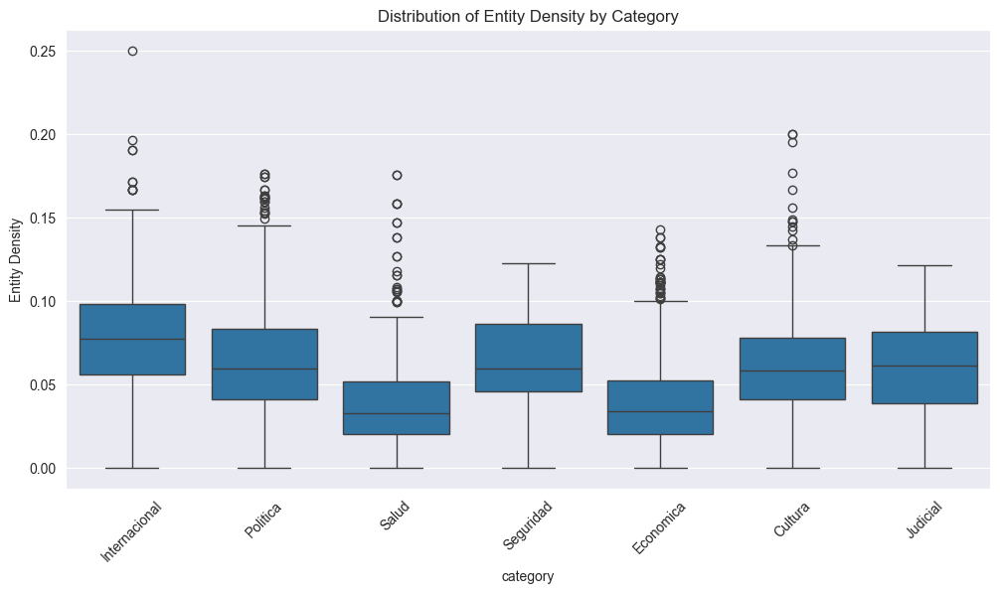

In [57]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="category", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Category")
plt.show()


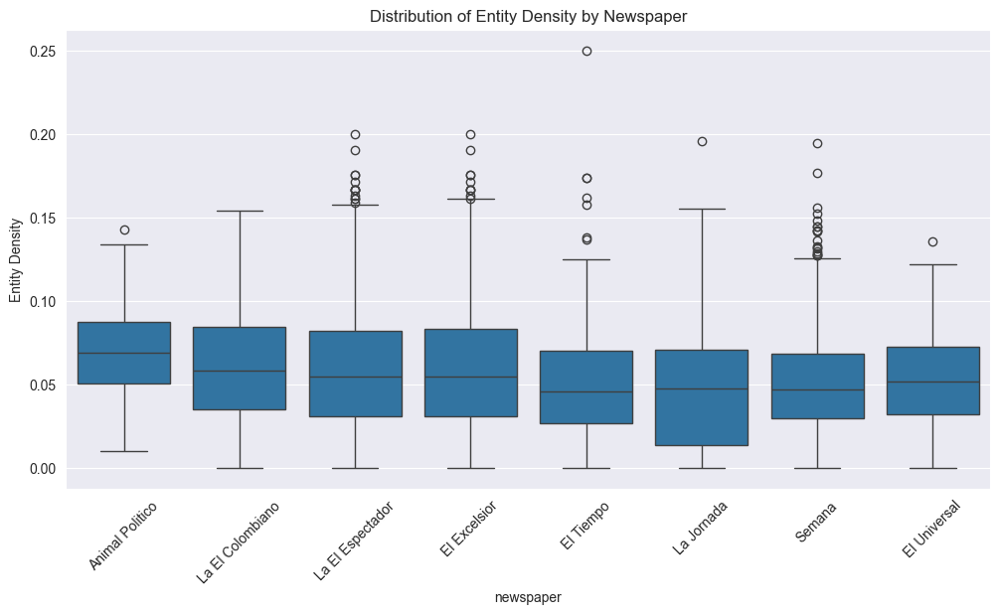

In [58]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="newspaper", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Newspaper")
plt.show()

#### Paso 3.3.5: ¿Qué entidades se asocian a los temas más recurrentes (por ejemplo, “ONU” con “Relaciones Internacionales”)?

In [59]:
# Make sure entities column is a list of tuples
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Extract only the entity text
df["entity_texts"] = df["entities"].apply(lambda ents: [e[0] for e in ents if isinstance(e, tuple)])

In [60]:
df_exploded = df.explode("entity_texts").dropna(subset=["entity_texts"])

In [61]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [62]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [63]:
top_entities_per_category = (
    entity_topic_freq.groupby("category")
    .head(10)  # top 10 entities per category
)
top_entities_per_category


,category,entity_texts,frequency
1890,Cultura,bogota,457
3271,Cultura,colombia,451
10157,Cultura,medellin,225
13940,Cultura,semán,199
10365,Cultura,mexico,192
...,...,...,...
41823,Seguridad,hernar bermudez,21
41597,Seguridad,bbc news mundo,18
41745,Seguridad,facebook canal,18
42146,Seguridad,seguirno youtube,18


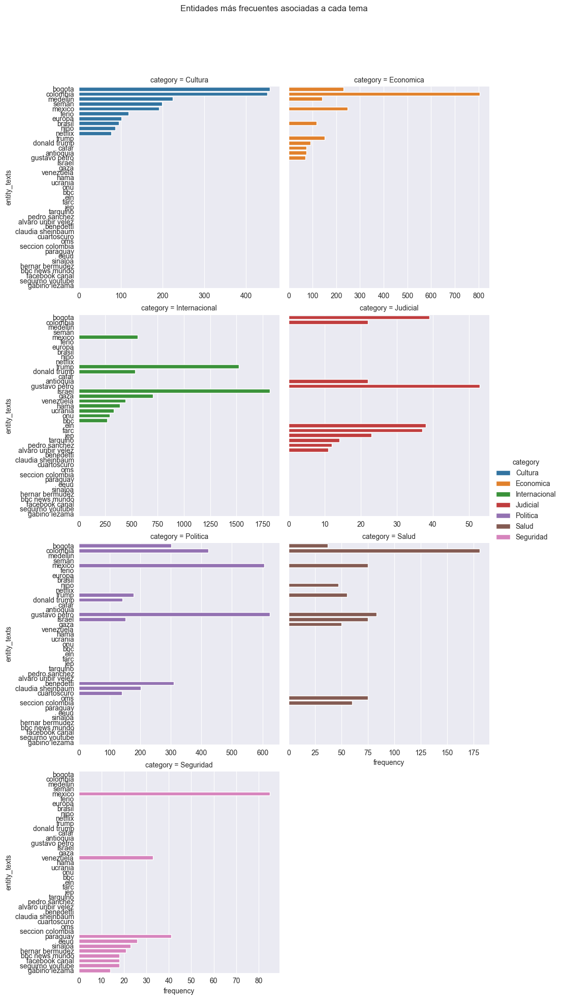

In [64]:
import seaborn as sns
import matplotlib.pyplot as plt

g = sns.catplot(
    data=top_entities_per_category,
    x="frequency",
    y="entity_texts",
    hue="category",
    kind="bar",
    col="category",
    col_wrap=2,
    dodge=False,
    sharex=False,
    height=5
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Entidades más frecuentes asociadas a cada tema")
plt.show()

### Paso 3.4: Análisis morfosintáctico y de estilo

Propósito: Detectar diferencias en el estilo periodístico y la estructura gramatical que podrían influir en el tipo de preguntas o respuestas que se pueden generar.

#### Paso 3.4.1: ¿Qué categorías gramaticales (sustantivos, verbos, adjetivos, etc.) predominan en cada país o sección?

In [65]:
def get_pos_tags(text):
    """
    Input: string
    Output: list of POS tags
    """
    doc = nlp(text)
    return [token.pos_ for token in doc]


In [66]:
# Create a new column with POS tags
df["pos_tags"] = df["content"].apply(lambda x: get_pos_tags(x) if isinstance(x, str) else [])

In [67]:
df_pos = df.explode("pos_tags").dropna(subset=["pos_tags"])

In [68]:
pos_counts = (
    df_pos.groupby(["country", "category", "pos_tags"])
    .size()
    .reset_index(name="count")
    .sort_values(["country", "category", "count"], ascending=[True, True, False])
)
pos_counts.head(20)

,country,category,pos_tags,count
7,Colombia,Cultura,NOUN,190251
1,Colombia,Cultura,ADP,146372
5,Colombia,Cultura,DET,132418
12,Colombia,Cultura,PUNCT,131508
16,Colombia,Cultura,VERB,90159
11,Colombia,Cultura,PROPN,82324
0,Colombia,Cultura,ADJ,68211
10,Colombia,Cultura,PRON,57616
4,Colombia,Cultura,CCONJ,36297
2,Colombia,Cultura,ADV,34045


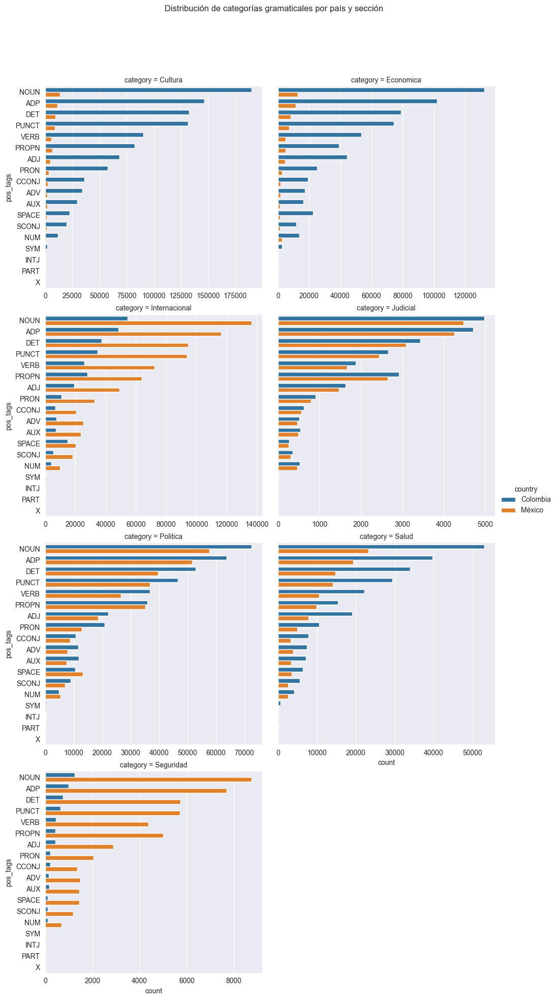

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example: POS distribution per country
g = sns.catplot(
    data=pos_counts,
    x="count",
    y="pos_tags",
    hue="country",
    col="category",  # optional, to separate by section
    kind="bar",
    col_wrap=2,
    sharex=False,
    height=5,
    dodge=True
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Distribución de categorías gramaticales por país y sección")
plt.show()

#### Paso 3.4.2: ¿Qué tan diversa es la estructura léxica entre secciones (índices de diversidad léxica o entropía)?

In [70]:
# If content_tokens are already tokenized
def lexical_diversity(tokens):
    if len(tokens) == 0:
        return 0
    return len(set(tokens)) / len(tokens)

# Apply per text
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: lexical_diversity(x) if isinstance(x, list) else 0)


In [71]:
lex_div_by_category = (
    df.groupby("category")["lexical_diversity"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
lex_div_by_category


,category,lexical_diversity
0,Judicial,0.792341
1,Salud,0.758182
2,Cultura,0.754181
3,Economica,0.743021
4,Politica,0.733451
5,Internacional,0.727534
6,Seguridad,0.697251


In [72]:
def shannon_entropy(tokens):
    if not tokens:
        return 0
    counts = np.array(list(Counter(tokens).values()))
    probs = counts / counts.sum()
    return -(probs * np.log2(probs)).sum()

# Apply per text
df["entropy"] = df["content_tokens"].apply(lambda x: shannon_entropy(x) if isinstance(x, list) else 0)

In [73]:
entropy_by_category = (
    df.groupby("category")["entropy"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
entropy_by_category


,category,entropy
0,Seguridad,7.742374
1,Cultura,7.273735
2,Internacional,7.209182
3,Economica,6.891542
4,Salud,6.728106
5,Politica,6.705495
6,Judicial,5.979230


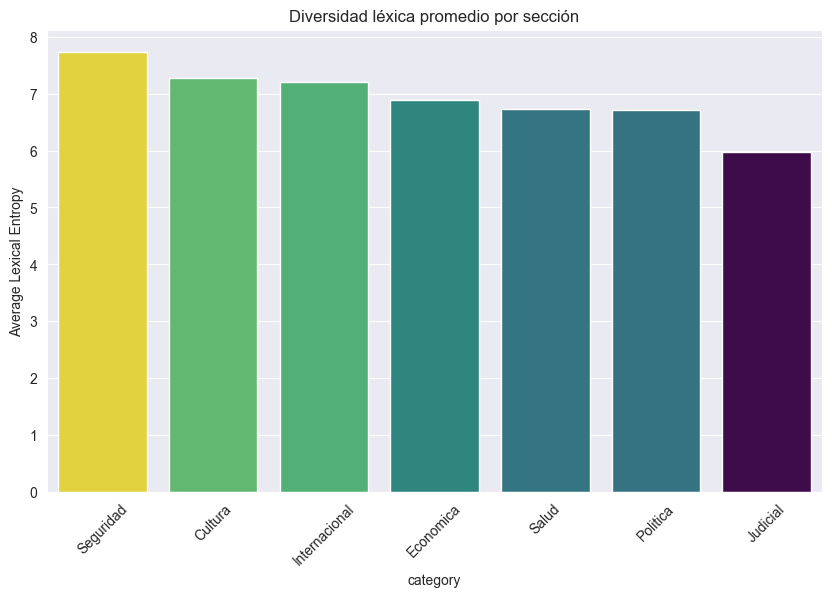

In [74]:
plt.figure(figsize=(10,6))
sns.barplot(data=entropy_by_category, x="category", y="entropy", hue="entropy", palette="viridis", legend=False)
plt.xticks(rotation=45)
plt.ylabel("Average Lexical Entropy")
plt.title("Diversidad léxica promedio por sección")
plt.show()

#### Paso 3.4.3: ¿Existen patrones de estilo o formalidad distintos por tipo de periódico o país?

In [78]:
# Longitud promedio de oraciones
df["avg_sentence_length"] = df["content_sentence_tokenization"].apply(
    lambda sents: np.mean([len(sent.split()) for sent in sents]) if isinstance(sents, list) and len(sents) > 0 else 0
)

# Longitud promedio de palabras
df["avg_word_length"] = df["content_tokens"].apply(
    lambda tokens: np.mean([len(token) for token in tokens]) if isinstance(tokens, list) and len(tokens) > 0 else 0
)


In [79]:
df["flesch_reading_ease"] = df["content_removed_unwanted_elements"].apply(lambda x: textstat.flesch_reading_ease(x) if isinstance(x, str) else 0)

In [80]:
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: len(set(x))/len(x) if len(x) > 0 else 0)

In [81]:
df_grouped = df.groupby(["country", "newspaper"]).agg({
    "flesch_reading_ease": "mean",
    "avg_sentence_length": "mean",
    "lexical_diversity": "mean"
}).reset_index()

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)


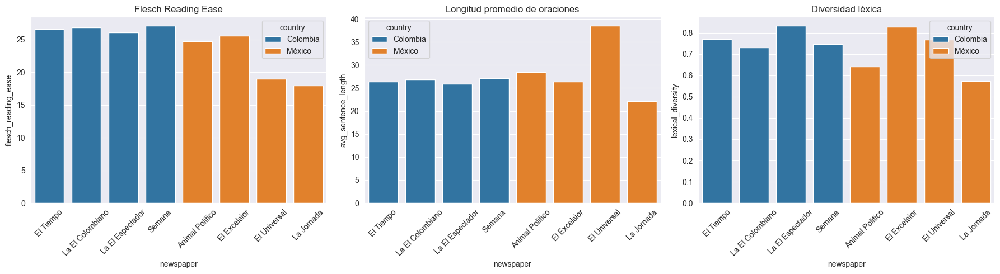

In [82]:
fig, axes = plt.subplots(1, 3, figsize=(18,5))

sns.barplot(data=df_grouped, x="newspaper", y="flesch_reading_ease", hue="country", ax=axes[0])
axes[0].set_title("Flesch Reading Ease")
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="avg_sentence_length", hue="country", ax=axes[1])
axes[1].set_title("Longitud promedio de oraciones")
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="lexical_diversity", hue="country", ax=axes[2])
axes[2].set_title("Diversidad léxica")
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)

plt.tight_layout()
plt.show()


## Paso 4: Desarrollar la metodología para generar preguntas y respuestas automáticas

Propósito:
Evaluar la calidad estructural y semántica de los textos para determinar su potencial en la generación automática de preguntas y respuestas.

### Paso 4.1: ¿Qué porcentaje de noticias tiene párrafos con oraciones bien formadas (sin errores o repeticiones)?

In [83]:
def is_well_formed_sentence(sent):
    sent = sent.strip()
    if len(sent) == 0:
        return False

    # Remove leading non-letter characters (quotes, parentheses, etc.)
    first_char = re.sub(r'^[^A-Za-zÁÉÍÓÚÑáéíóúñ]+', '', sent)
    if len(first_char) == 0:
        return False

    # Check if starts with uppercase
    if not first_char[0].isupper():
        return False

    # Check if ends with valid punctuation
    if sent[-1] not in ".!?":
        return False

    # Check repeated words
    words = [unidecode.unidecode(w.lower()) for w in sent.split()]
    for i in range(len(words)-1):
        if words[i] == words[i+1]:
            return False

    return True

In [84]:
def is_well_formed_paragraph(paragraph):
    sentences = re.split(r'(?<=[.!?¿¡]) +', paragraph)
    if len(sentences) == 0:
        return False

    # Paragraph is well-formed if all sentences are well-formed
    return all(is_well_formed_sentence(s) for s in sentences)

In [88]:
# Apply to dataframe
df["well_formed_paragraph"] = df["content_removed_unwanted_elements"].apply(
    lambda x: is_well_formed_paragraph(x) if isinstance(x, str) else False
)

In [89]:
# Compute percentage of well-formed paragraphs
percentage = df["well_formed_paragraph"].mean() * 100
print(f"Porcentaje de noticias con párrafos bien formados: {percentage:.2f}%")

Porcentaje de noticias con párrafos bien formados: 44.67%


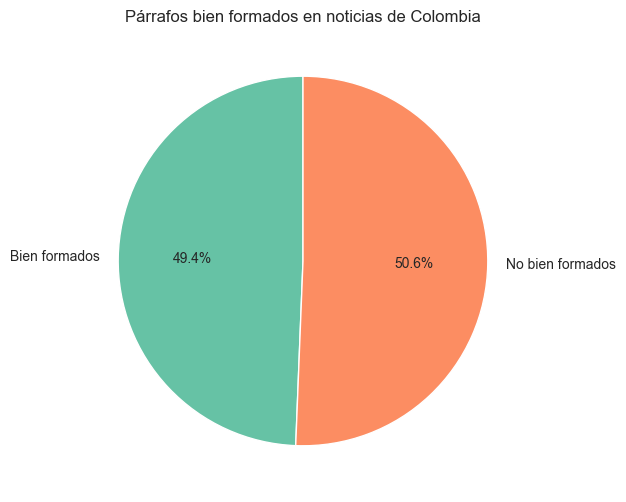

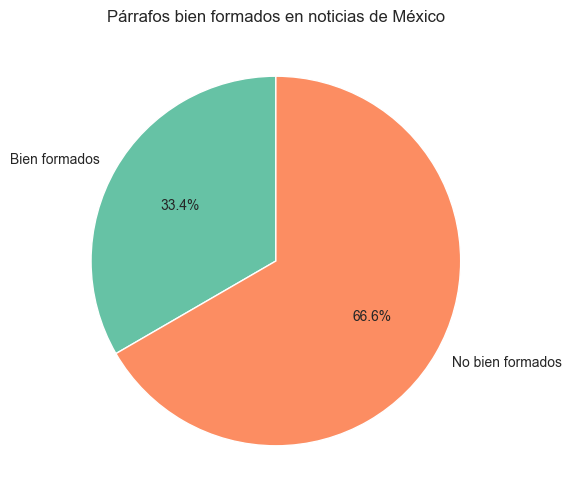

In [93]:
# Compute counts per country
df_grouped = df.groupby("country")["well_formed_paragraph"].mean().reset_index()
df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

for i, row in df_grouped.iterrows():
    labels = ["Bien formados", "No bien formados"]
    sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]

    plt.figure(figsize=(6,6))
    plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
    plt.title(f"Párrafos bien formados en noticias de {row['country']}")
    plt.show()


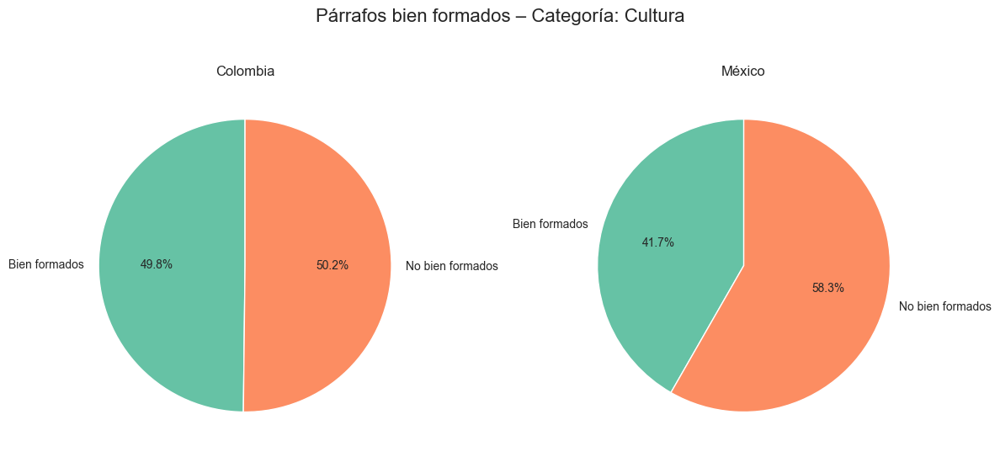

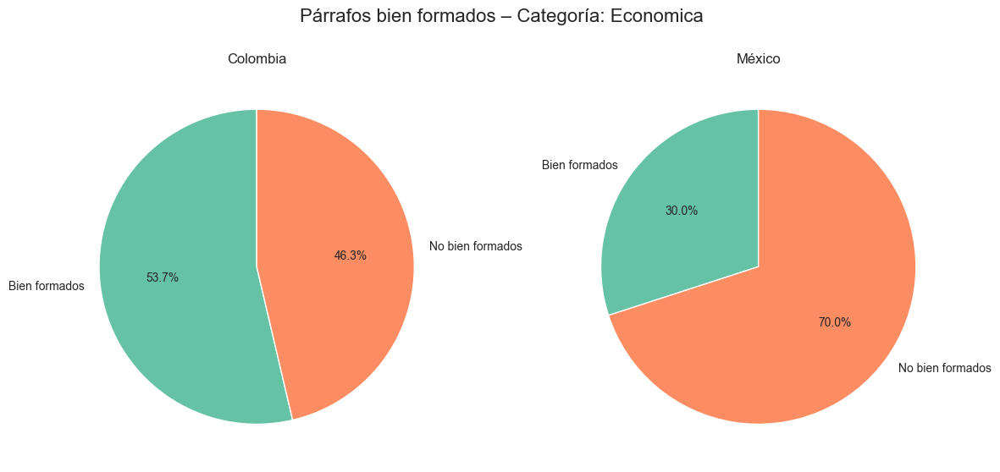

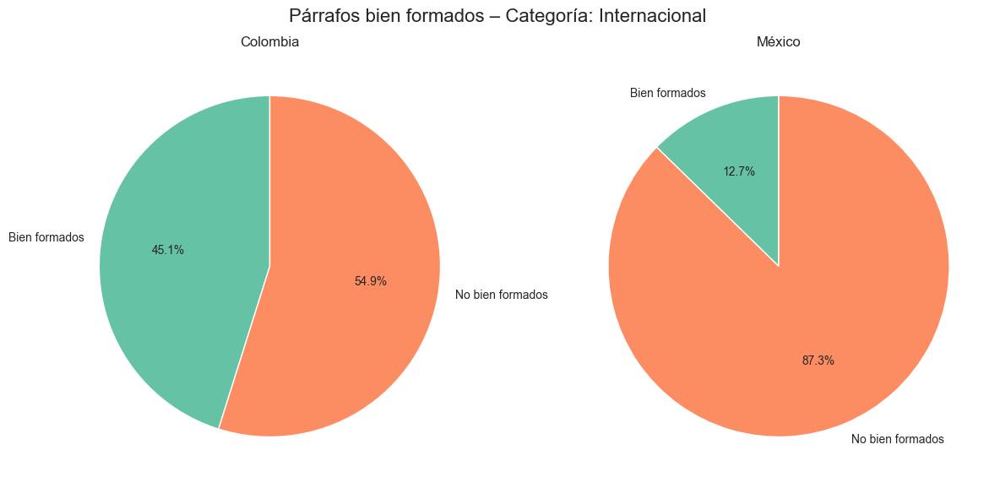

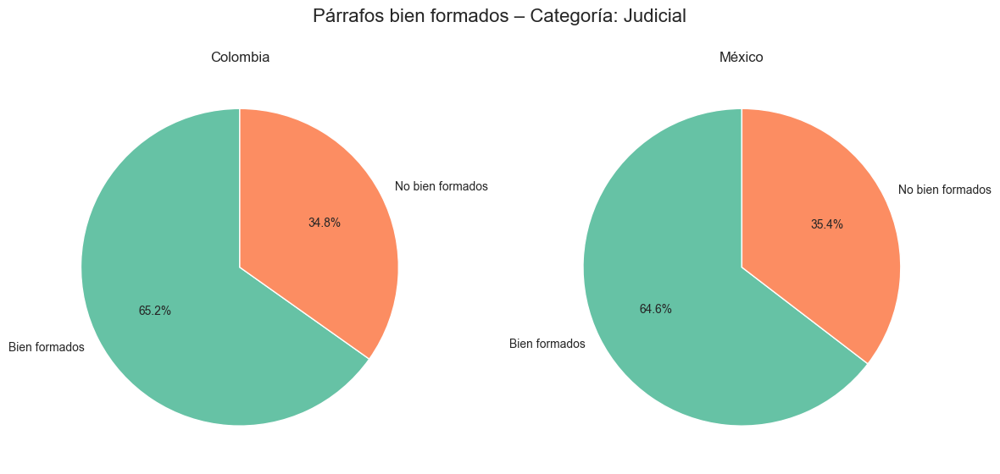

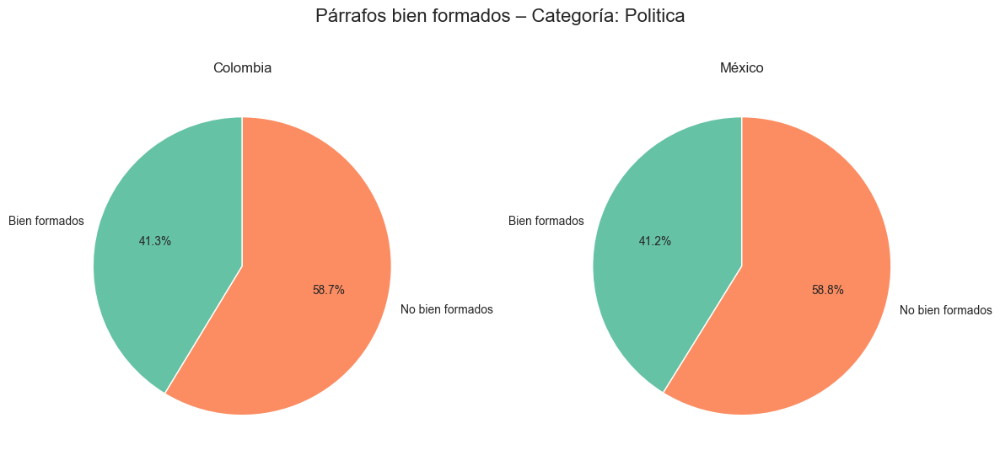

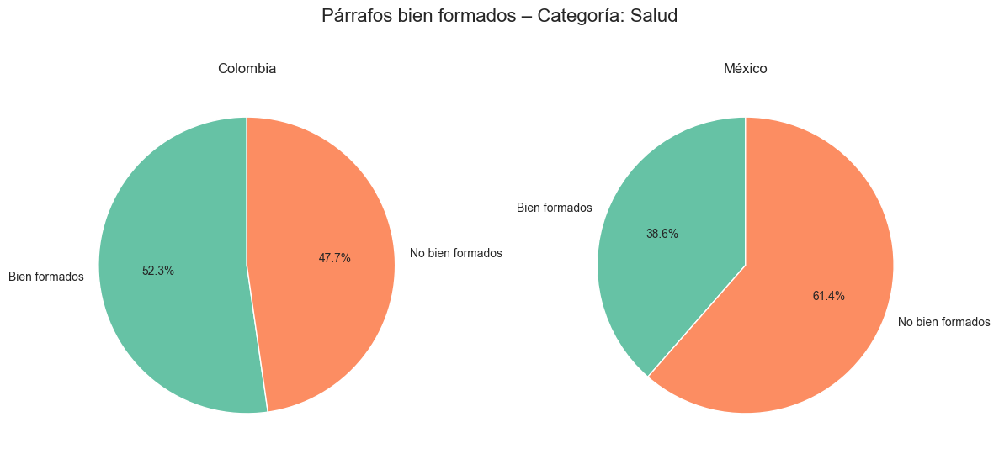

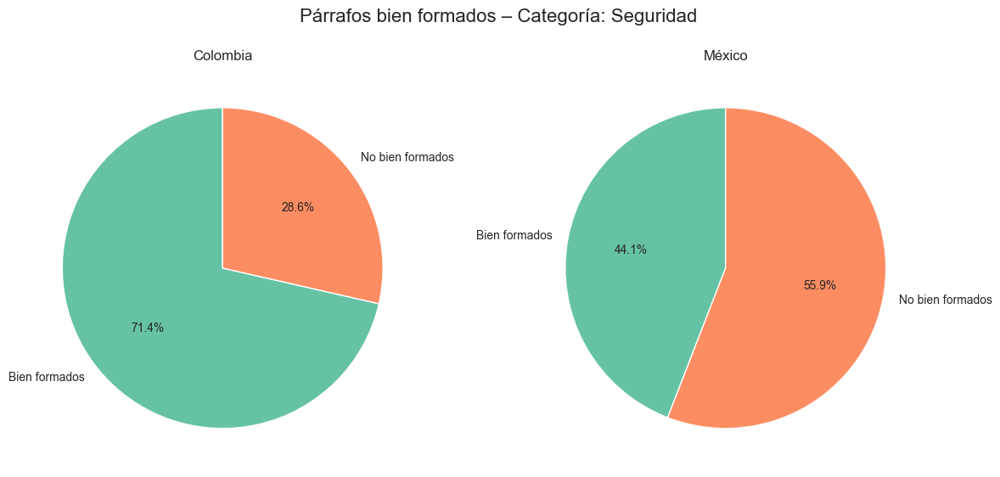

In [95]:
# Compute mean well-formed paragraphs per country and category
df_grouped = (
    df.groupby(["country", "category"])["well_formed_paragraph"]
    .mean()
    .reset_index()
)

df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

categories = df_grouped["category"].unique()

for category in categories:
    subset = df_grouped[df_grouped["category"] == category]

    fig, axes = plt.subplots(1, 2, figsize=(12,6))
    fig.suptitle(f"Párrafos bien formados – Categoría: {category}", fontsize=16)

    for ax, (idx, row) in zip(axes, subset.iterrows()):
        labels = ["Bien formados", "No bien formados"]
        sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]
        ax.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
        ax.set_title(row["country"])

    plt.tight_layout()
    plt.show()

### Paso 4.2: ¿Qué tan frecuentes son los encabezados útiles para formar preguntas?

In [96]:
# Asegurarnos de que los títulos sean strings
df["title"] = df["title"].astype(str)

In [97]:
def is_useful_title(text):
    doc = nlp(text)
    # Útil si hay un verbo o entidad nombrada
    has_verb = any(tok.pos_ == "VERB" for tok in doc)
    has_entity = any(ent.label_ in ["PER", "LOC", "ORG", "MISC"] for ent in doc.ents)
    return has_verb or has_entity

df["useful_title"] = df["title"].apply(is_useful_title)

In [98]:
freq_useful = df["useful_title"].mean() * 100
print(f"Porcentaje de títulos útiles: {freq_useful:.2f}%")

Porcentaje de títulos útiles: 98.21%


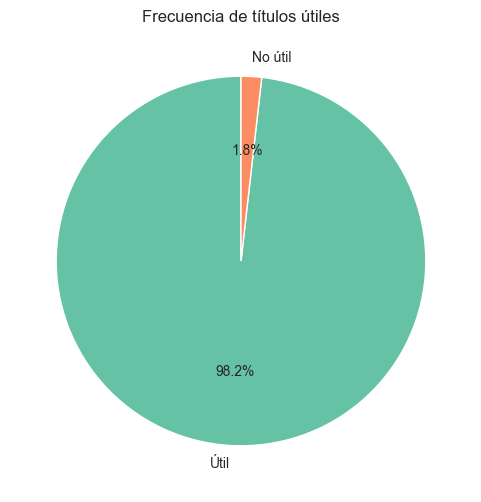

In [99]:
sizes = [
    df["useful_title"].sum(),
    len(df) - df["useful_title"].sum()
]
labels = ["Útil", "No útil"]
colors = ["#66c2a5","#fc8d62"]

plt.figure(figsize=(6,6))
plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=colors)
plt.title("Frecuencia de títulos útiles")
plt.show()

### Paso 4.3: ¿Cuántas entidades nombradas (personas, lugares, fechas, organizaciones) hay por texto?

In [100]:
# Count entities per text
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Quick summary
print(df[["num_entities"]].describe())

       num_entities
count   5635.000000
mean      17.469033
std       21.988457
min        0.000000
25%        5.000000
50%       11.000000
75%       22.000000
max      335.000000


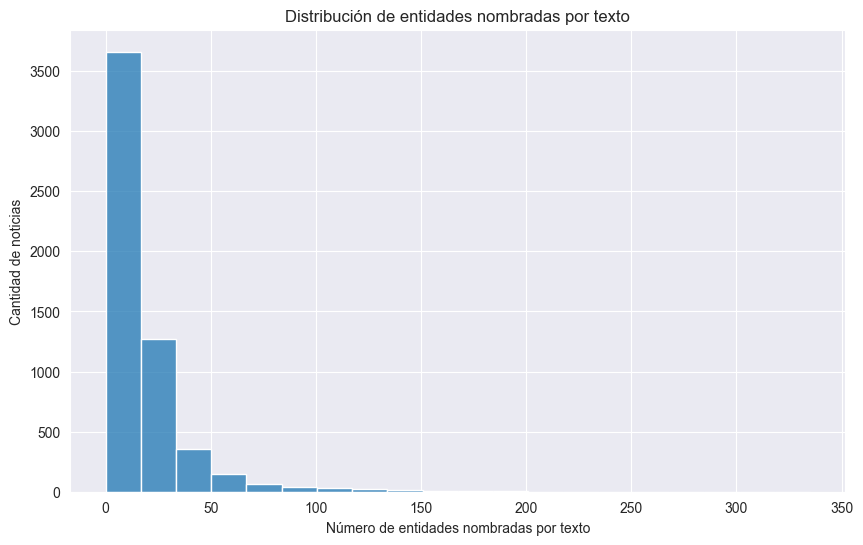

In [101]:
plt.figure(figsize=(10,6))
sns.histplot(df["num_entities"], bins=20, kde=False)
plt.xlabel("Número de entidades nombradas por texto")
plt.ylabel("Cantidad de noticias")
plt.title("Distribución de entidades nombradas por texto")
plt.show()

     country       category   count       mean        std   min   25%   50%  \
0   Colombia        Cultura  1118.0  21.906977  17.412946   0.0  10.0  19.0   
1   Colombia      Economica  1010.0   9.942574   8.538299   0.0   4.0   8.0   
2   Colombia  Internacional   556.0  18.140288  12.762915   0.0   8.0  16.0   
3   Colombia       Judicial   112.0   5.696429   4.553663   0.0   3.0   5.0   
4   Colombia       Politica   714.0  13.920168  12.302091   0.0   5.0  12.0   
5   Colombia          Salud   463.0   7.827214   7.269425   0.0   3.0   6.0   
6   Colombia      Seguridad     7.0  20.428571  11.296860  10.0  13.0  17.0   
7     México        Cultura   187.0   9.128342  15.802702   0.0   2.0   5.0   
8     México      Economica   200.0   6.785000   8.343070   0.0   1.0   4.0   
9     México  Internacional   449.0  51.204900  46.323618   0.0   9.0  46.0   
10    México       Judicial    96.0   5.895833   4.848177   0.0   3.0   5.0   
11    México       Politica   549.0  15.493625  14.8

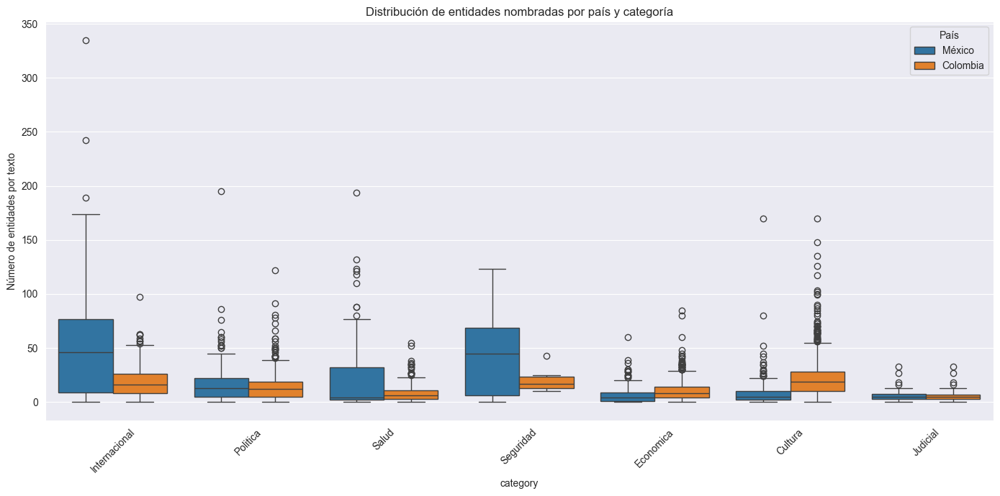

In [102]:
# Count entities per text (if not already done)
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Aggregate by country and category
agg_df = df.groupby(["country", "category"])["num_entities"].describe().reset_index()
print(agg_df[["country","category","count","mean","std","min","25%","50%","75%","max"]])

# Boxplot per country and category
plt.figure(figsize=(14,7))
sns.boxplot(data=df, x="category", y="num_entities", hue="country")
plt.xticks(rotation=45)
plt.ylabel("Número de entidades por texto")
plt.title("Distribución de entidades nombradas por país y categoría")
plt.legend(title="País")
plt.tight_layout()
plt.show()

### Paso 4.4: ¿Qué tipos de entidades predominan (PERSON, LOC, ORG, DATE, EVENT)?

  entity_type  entity_text
3         PER        51115
0         LOC        24926
1        MISC        11774
2         ORG        10623


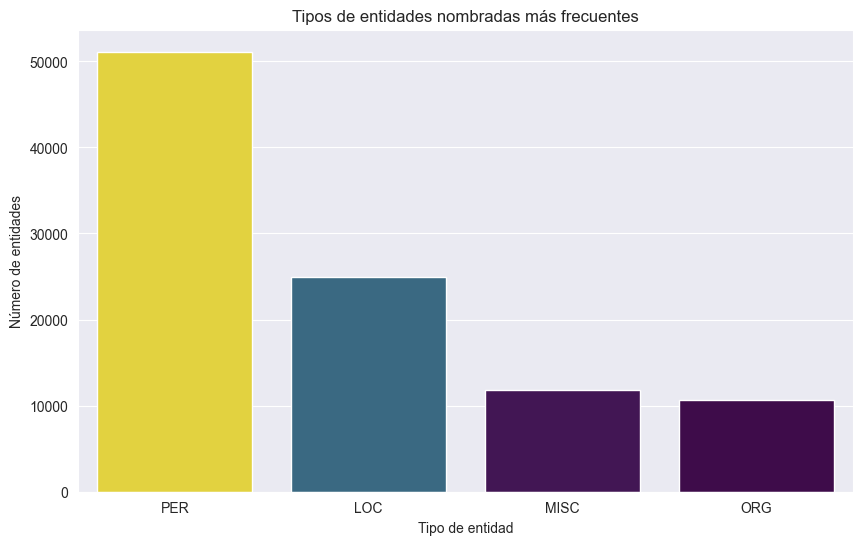

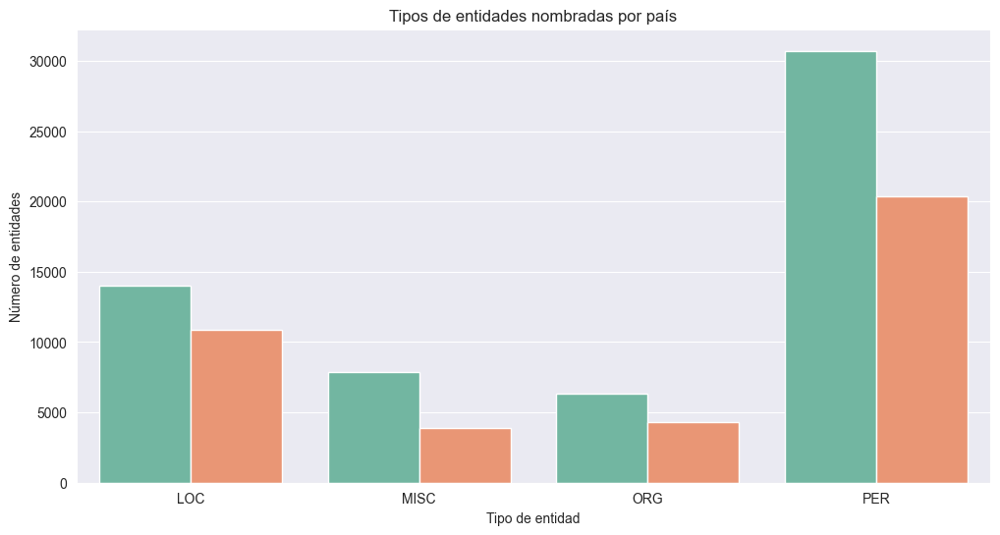

In [104]:
# Ensure 'entities' column has format [(text, type), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Count occurrences per entity type (overall)
entity_counts = df_entities.groupby("entity_type")["entity_text"].count().reset_index()
entity_counts = entity_counts.sort_values(by="entity_text", ascending=False)
print(entity_counts)

# Plot overall
plt.figure(figsize=(10,6))
sns.barplot(data=entity_counts, x="entity_type", y="entity_text", hue="entity_text", palette="viridis", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas más frecuentes")
plt.show()

# Optional: By country
entity_counts_country = df_entities.groupby(["country","entity_type"])["entity_text"].count().reset_index()
plt.figure(figsize=(12,6))
sns.barplot(data=entity_counts_country, x="entity_type", y="entity_text", hue="country", palette="Set2", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas por país")
plt.show()

### Paso 4.5: ¿Qué porcentaje de oraciones contiene información factual que podría servir como respuesta?

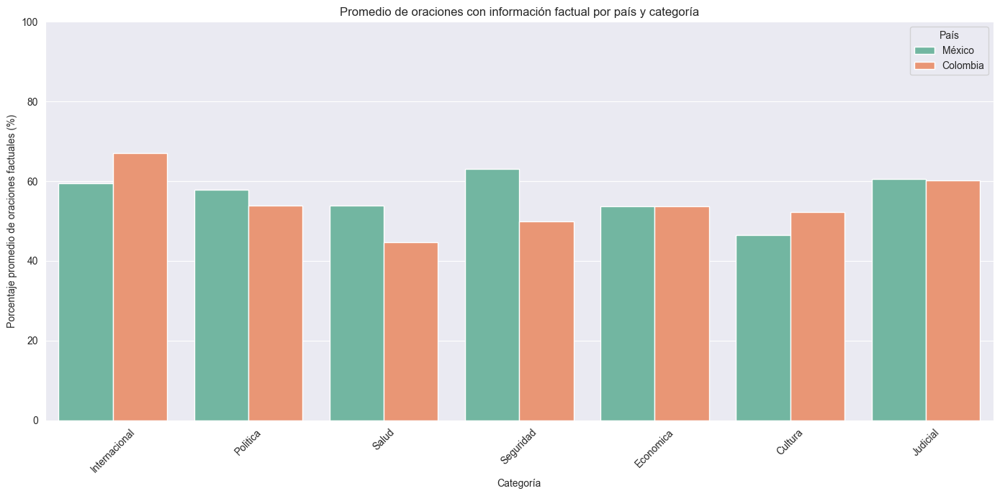

In [112]:
# Function to check if a sentence is factual
def is_factual(sentence, entities=[]):
    """
    Simple heuristic:
    - A sentence is factual if it contains a named entity or a number/date
    """
    if not sentence:
        return False
    for ent in entities:
        if isinstance(ent, tuple) and ent[0] in sentence:
            return True
    if any(char.isdigit() for char in sentence):
        return True
    return False

# Prepare a DataFrame to store results
rows = []

for country in df["country"].unique():
    for category in df["category"].unique():
        subset = df[(df["country"] == country) & (df["category"] == category)]
        percentages = []
        for _, row in subset.iterrows():
            sentences = row.get("content_sentence_tokenization", [])
            entities = row.get("entities", [])
            if not isinstance(sentences, list) or not sentences:
                continue
            factual = [s for s in sentences if is_factual(s, entities)]
            percentages.append(len(factual)/len(sentences))
        if percentages:
            rows.append({
                "country": country,
                "category": category,
                "factual_percentage": sum(percentages)/len(percentages) * 100
            })

plot_df = pd.DataFrame(rows)

# Plot with Seaborn using standard deviation as confidence interval
plt.figure(figsize=(14,7))
sns.barplot(
    data=plot_df,
    x="category",
    y="factual_percentage",
    hue="country",
    errorbar='sd',
    palette="Set2"
)
plt.ylabel("Porcentaje promedio de oraciones factuales (%)")
plt.xlabel("Categoría")
plt.title("Promedio de oraciones con información factual por país y categoría")
plt.ylim(0,100)
plt.xticks(rotation=45)
plt.legend(title="País")
plt.tight_layout()
plt.show()


In [113]:
# Overall average factual percentage across all texts
overall_avg = plot_df["factual_percentage"].mean()
print(f"Porcentaje promedio de oraciones factuales en todos los textos: {overall_avg:.2f}%")

Porcentaje promedio de oraciones factuales en todos los textos: 55.48%
